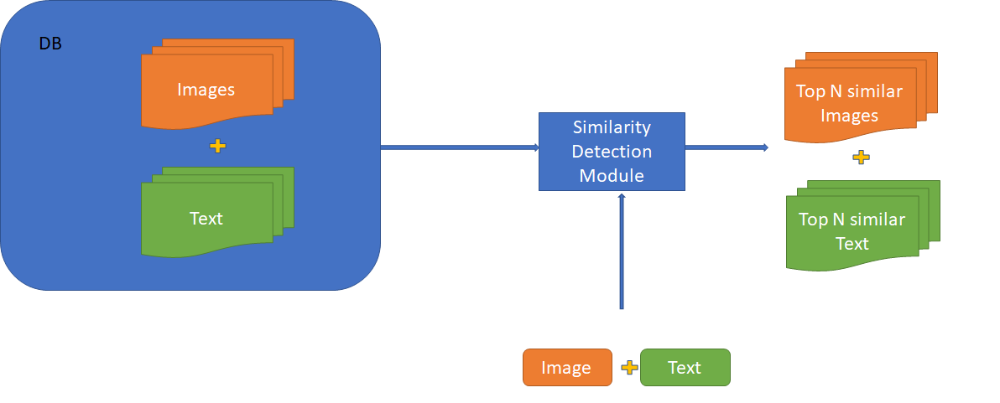

In [1]:

import numpy as np
import pandas as pd
import tensorflow as tf

In [2]:
train_df = pd.read_csv('train.csv')

In [3]:
train_df.head(10)

,posting_id,image,image_phash,title,label_group
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069
5,train_2464356923,0013e7355ffc5ff8fb1ccad3e42d92fe.jpg,bbd097a7870f4a50,CELANA WANITA (BB 45-84 KG)Harem wanita (bisa...,2660605217
6,train_1802986387,00144a49c56599d45354a1c28104c039.jpg,f815c9bb833ab4c8,Jubah anak size 1-12 thn,1835033137
7,train_1806152124,0014f61389cbaa687a58e38a97b6383d.jpg,eea7e1c0c04da33d,KULOT PLISKET SALUR /CANDY PLISKET /WISH KULOT...,1565741687
8,train_86570404,0019a3c6755a194cb2e2c12bfc63972e.jpg,ea9af4f483249972,"[LOGU] Tempelan kulkas magnet angka, tempelan ...",2359912463
9,train_831680791,001be52b2beec40ddc1d2d7fc7a68f08.jpg,e1ce953d1a70618f,BIG SALE SEPATU PANTOFEL KULIT KEREN KERJA KAN...,2630990665


In [4]:
print(len(train_df))

34250


In [5]:
print(len(train_df['label_group'].unique()))


11014


'label_group' represents a set of products that are considered the same (i.e., they are matched as being the same product).

In [6]:
labelGroup_df = train_df.groupby('label_group')

In [7]:
import matplotlib.pyplot as plt
from PIL import Image

In [8]:
labelGroup_df.head()

,posting_id,image,image_phash,title,label_group
0,train_129225211,0000a68812bc7e98c42888dfb1c07da0.jpg,94974f937d4c2433,Paper Bag Victoria Secret,249114794
1,train_3386243561,00039780dfc94d01db8676fe789ecd05.jpg,af3f9460c2838f0f,"Double Tape 3M VHB 12 mm x 4,5 m ORIGINAL / DO...",2937985045
2,train_2288590299,000a190fdd715a2a36faed16e2c65df7.jpg,b94cb00ed3e50f78,Maling TTS Canned Pork Luncheon Meat 397 gr,2395904891
3,train_2406599165,00117e4fc239b1b641ff08340b429633.jpg,8514fc58eafea283,Daster Batik Lengan pendek - Motif Acak / Camp...,4093212188
4,train_3369186413,00136d1cf4edede0203f32f05f660588.jpg,a6f319f924ad708c,Nescafe \xc3\x89clair Latte 220ml,3648931069
...,...,...,...,...,...
34244,train_945815402,fff1222750374ddbed82b17c8bd2766d.jpg,b0cbce308fcdcc64,Baterai Batre Battery Xiaomi Redmi Note 3 BM46...,3091541662
34245,train_4028265689,fff1c07ceefc2c970a7964cfb81981c5.jpg,e3cd72389f248f21,Masker Bahan Kain Spunbond Non Woven 75 gsm 3 ...,3776555725
34246,train_769054909,fff401691371bdcb382a0d9075dfea6a.jpg,be86851f72e2853c,MamyPoko Pants Royal Soft - S 70 - Popok Celana,2736479533
34248,train_3630949769,fff51b87916dbfb6d0f8faa01bee67b8.jpg,e3b13bd1d896c05c,"Kaldu NON MSG HALAL Mama Kamu Ayam Kampung , S...",1663538013


In [10]:
for groupName, groupDf in labelGroup_df:
    print(groupName, groupDf)

258047              posting_id                                 image  \
3874   train_1646767365  1d7aadc7503b2b4539cc9a5fe41979dd.jpg   
6738    train_398181303  3301b8aaccea93d1098995ffbc537335.jpg   
31859  train_1528423085  eec692257e74fcbc6cb63cb76d0f20e7.jpg   

            image_phash                                              title  \
3874   e925873ed09cd08f  Sarung celana wadimor original 100% dewasa dan...   
6738   e9b5833e929e909c    SARUNG CELANA WADIMOR DEWASA HITAM POLOS SARCEL   
31859  ea97861c926a71e3  WARNA RANDOM ACAK Sarung Celana Wadimor MURAH ...   

       label_group  
3874        258047  
6738        258047  
31859       258047  
297977              posting_id                                 image  \
7613   train_2865605743  3977f4e7a47c73568c5e9fcb61723b4b.jpg   
12367  train_1382500866  5d075d7eaa258052ab125c75c06293d6.jpg   

            image_phash                                              title  \
7613   bfc3cc1cc636c14c  Wall Sticker / WallSticker - 

258047
Sarung celana wadimor original 100% dewasa dan anak hitam dan putih polos


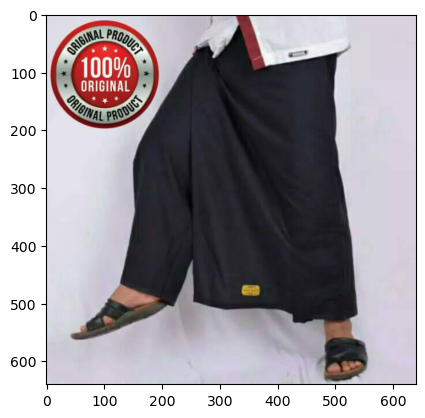

SARUNG CELANA WADIMOR DEWASA HITAM POLOS SARCEL


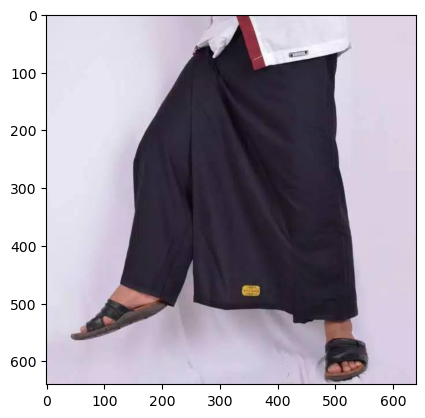

WARNA RANDOM ACAK Sarung Celana Wadimor MURAH Celana Sarung WADIMOR


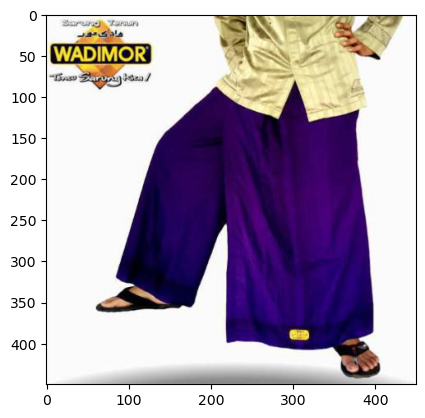

297977
Wall Sticker / WallSticker -  Submarine Measure - SK9222


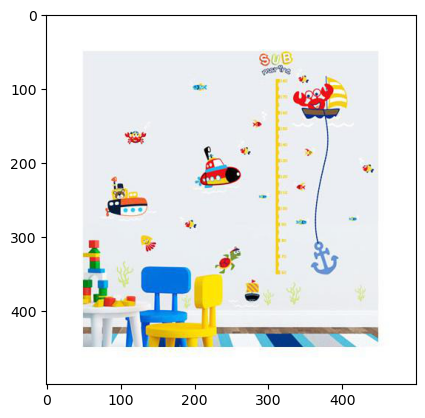

RELIZA WALL STICKER PENGUKUR TINGGI BADAN JERAPAH STIKER DINDING XL8337


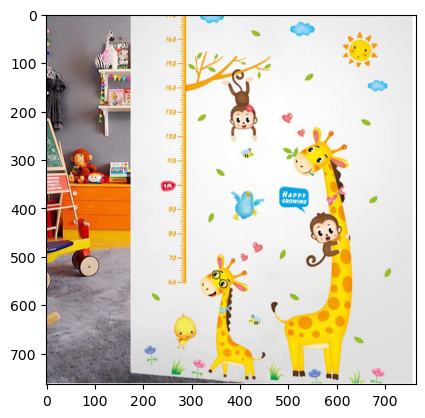

645628
GROSIR LVN COLLAGEN / COLAGEN STROBERI PEMUTIH KULIT 1 BOX ISI 10 SACHET


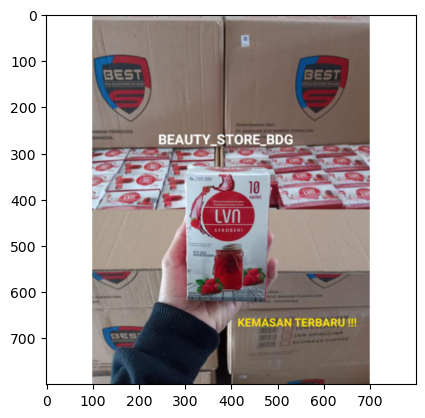

DISTRIBUTOR LVN COLLAGEN STROBERI / COLAGEN 1 BOX (10 sachet)


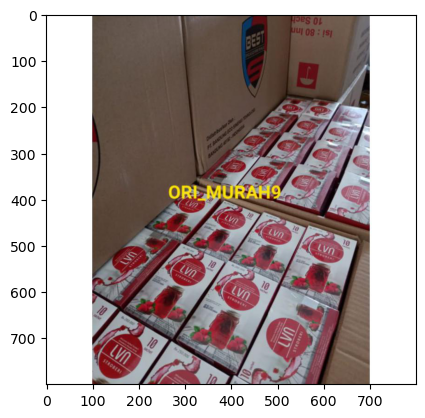

TERMURAH LVN COLLAGEN STROBERI 1 BOX 10 SACHET


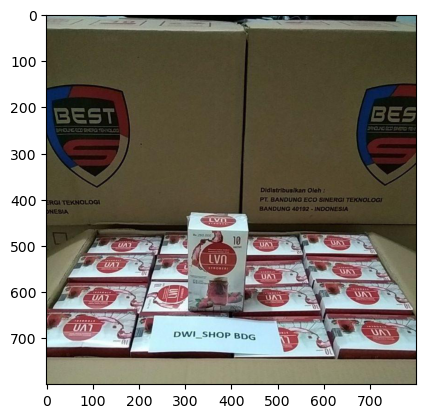

801176
mainan bayi gantung putar musik merry go round


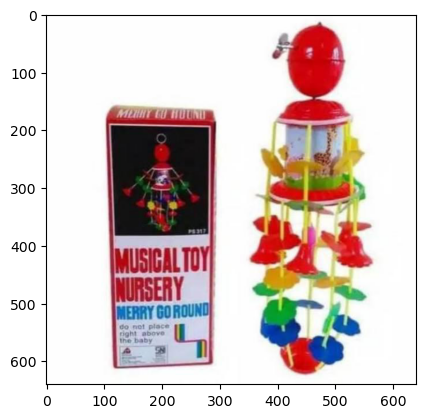

MERRY GO ROUND MAINAN BAYI GANTUNG MUSIK PUTAR/KERINCINGAN BAYI


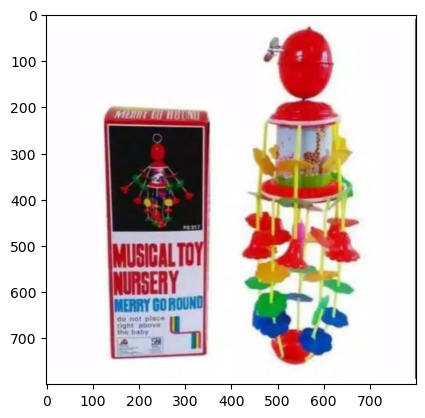

887886
TP-LINK Wireless N Router TL-WR940N 450Mbps TP LINK TL WR940N


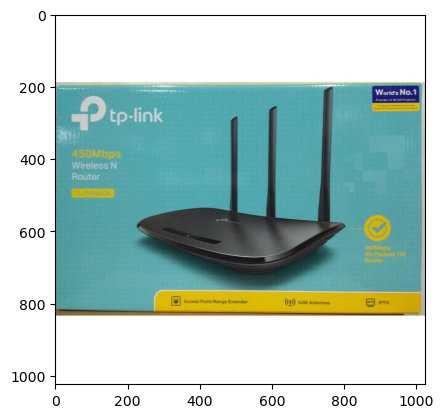

TP-LINK Wireless N Router TL-WR940N 450Mbps TP LINK


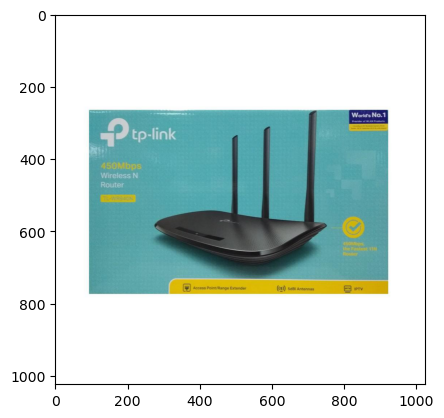

942089
Slim Door Guard Protector Pelindung Pintu Mobil Universal 8 pcs P-2


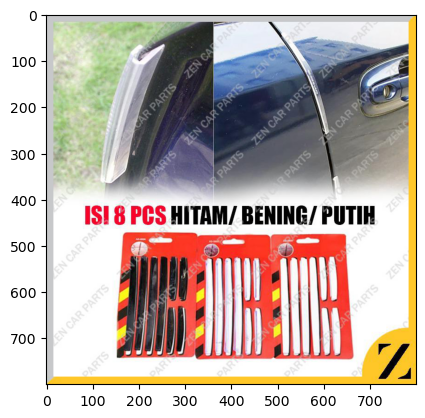

Pelindung Pintu Mobil Slim Door Guard Protector Universal 8 pcs HT-001


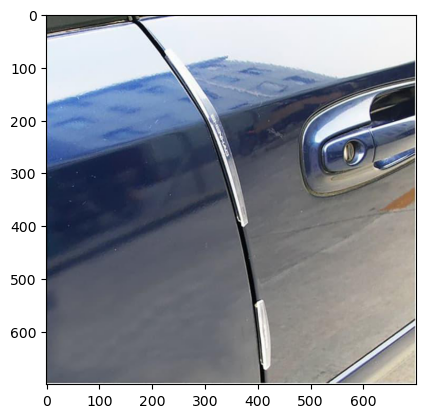

2942125
[Bayar Di Tempat]Perhiasan Bros Desain Kucing dengan Mutiara Imitasi Warna Putih untuk Wanita


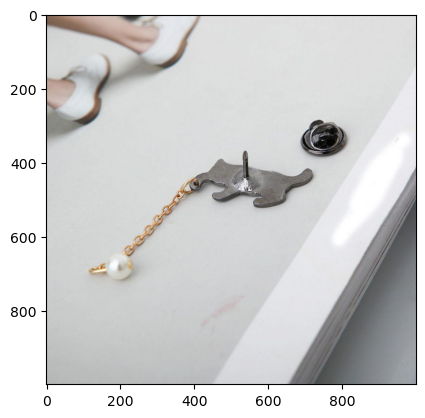

Bros Pin Bentuk Kartun Kucing Dengan Mutiara Imitasi Untuk Wanita


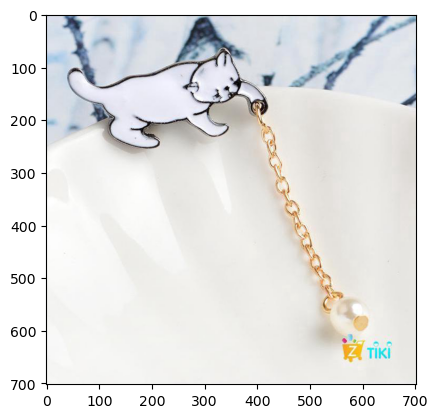

COD\xef\xbc\x88Yimi\xef\xbc\x89Kreatif Kecil Yang Lucu Putih Mutiara Kucing Bros Pins Chic Fashion Jewelry Bros


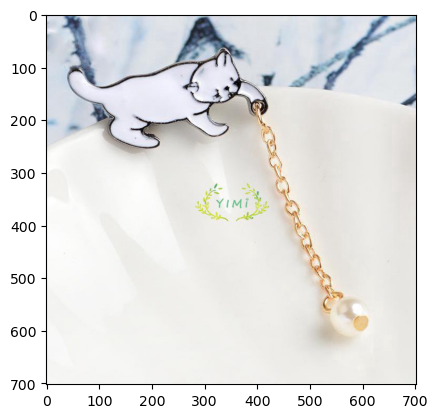

3108272
\xe2\x9c\xa8Co\xe2\x9c\xa8Sarung Jok Sepeda 3D Bahan Silikon Lembut


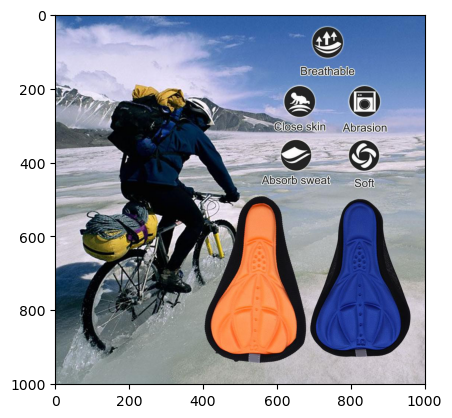

Sarung Jok Sepeda 3D Bahan Silikon Lembut


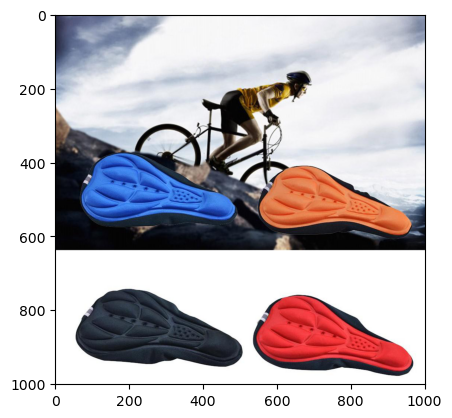

4063438
Headset U19 Hifi Macaroon Mate Color Hifi Extra Bass


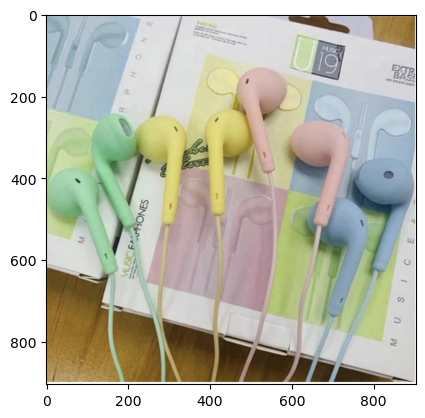

Earphone Macaron U19 VIVO


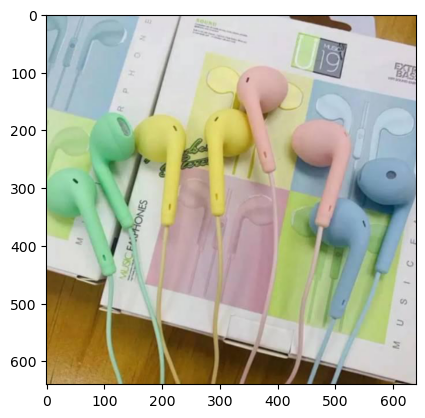

4262657
TU88 Pouch Kosmetik Bunny POMPOM Bahan Bulu Travel Pouch Cosmetic Organizer Kelinci - PBN


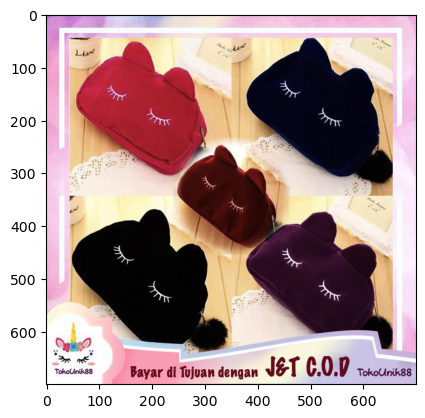

[OS821] POUCH KOSMETIK BUNNY POM POMPOM / POUCH KOSMETIK MINI / TAS KOSMETIK KECIL / POUCH KOSMETIK


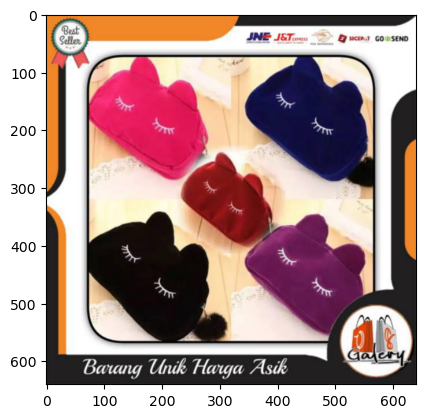

In [11]:
%matplotlib inline


groupCount = 0
for groupName,groupDf in labelGroup_df:
    print(groupName)
    imgCount=0
    for index,row in groupDf.iterrows():
        print(row['title'])
        imagePath = 'train_images/'+row['image']
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
        imgCount= imgCount+1
        if (imgCount==3):
            break
            
    groupCount = groupCount +1
    if (groupCount==10):
        break

In [12]:
from sklearn.model_selection import train_test_split


y = train_df.pop('label_group')
X = train_df

X_train,X_test,y_train,y_test = train_test_split(X,y,stratify=y,test_size=0.4,random_state=0)

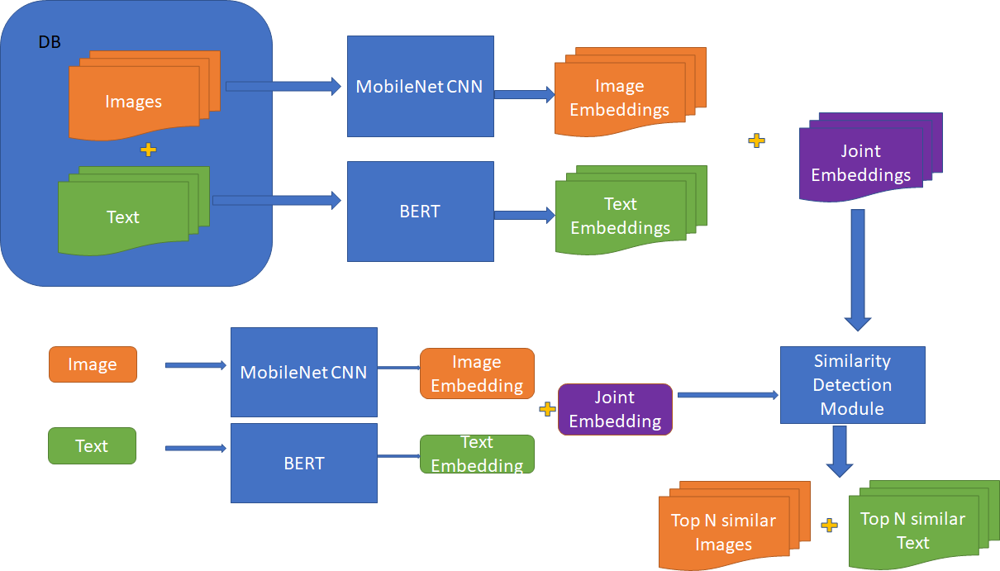

In [13]:
from sentence_transformers import SentenceTransformer, util
model = SentenceTransformer('stsb-distilbert-base')
model.max_seq_length = 128


c:\Users\RohithSai\Anaconda3\Lib\site-packages\sentence_transformers\cross_encoder\CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange


c:\Users\RohithSai\Anaconda3\Lib\site-packages\transformers\tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


The SentenceTransformer model ('stsb-distilbert-base') is loaded, which is designed for tasks like sentence similarity.

model.max_seq_length = 128: Sets the maximum sequence length for input text, meaning text longer than 128 tokens will be truncated.

In [14]:
IMG_SIZE = 224
size = (IMG_SIZE,IMG_SIZE)
img_model = tf.keras.applications.MobileNet(input_shape = (IMG_SIZE, IMG_SIZE, 3), include_top = False, weights = 'imagenet' )


IMG_SIZE = 224: Specifies that images should be resized to 224x224 pixels to match the input size expected by MobileNet.

include_top=False: This excludes the fully connected layers at the top of the network, leaving only the convolutional base, which outputs feature maps.

In [15]:
def get_textEmbeddings(model,text):
    text_embedding = model.encode(text, convert_to_tensor=True)
    return text_embedding

In [16]:
def get_imageEmbeddings(model,imagePath):
    image = tf.keras.preprocessing.image.load_img(imagePath,target_size= size)
    input_arr = tf.keras.preprocessing.image.img_to_array(image)
    input_arr = np.array([input_arr])
    img_embeddings = model(input_arr)
    meanImgEmb1 = np.mean(img_embeddings,axis =0)
    meanImgEmb2 = np.mean(meanImgEmb1,axis=0)
    meanImgEmb = np.mean(meanImgEmb2,axis=0)
    return meanImgEmb

In [17]:
print(np.shape(X_train))

(20550, 4)


In [18]:
import time
text_embeddings={}
image_embeddings={}
start_time = time.time()
for index,row in  X_train.iterrows():
    txt_emb = get_textEmbeddings(model,str(row[3]))
    imagePath = 'train_images/'+row[1]
    img_emb = get_imageEmbeddings(img_model,imagePath)
    text_embeddings[row[0]] = txt_emb
    image_embeddings[row[0]] = img_emb
end_time = time.time()
print(str(end_time-start_time))

    

C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\3584971552.py:6: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  txt_emb = get_textEmbeddings(model,str(row[3]))
C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\3584971552.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  imagePath = 'train_images/'+row[1]
C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\3584971552.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  te

2816.461766719818


In [19]:
import pickle
with open('./textEmb','wb') as handle:
    pickle.dump(text_embeddings,handle)
with open('./imgEmb','wb') as handle:
    pickle.dump(image_embeddings,handle)

In [20]:
keyList=[]
cembList=[]
imageList=[]
titleList=[]
for index, row in X_train.iterrows():
    #start_time=time.time()
    txt_emb = text_embeddings[row[0]]
    print(np.shape(txt_emb))
    img_emb = image_embeddings[row[0]] 
    print(np.shape(img_emb))
    cmb_emb = np.concatenate((txt_emb,img_emb),axis=0)
    print('shape of cmb_emb', np.shape(cmb_emb))
    norm = np.linalg.norm(cmb_emb)
    cmb_emb_normal = cmb_emb/norm
    keyList.append(row[0])
    cembList.append(cmb_emb_normal)
    imageList.append(row[1])
    titleList.append(row[3])

C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\2222038085.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  txt_emb = text_embeddings[row[0]]
C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\2222038085.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  img_emb = image_embeddings[row[0]]
C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\2222038085.py:15: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  keyList.append(

torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape of cmb_emb (1792,)
torch.Size([768])
(1024,)
shape

NearestNeighbors is an unsupervised learning algorithm used to find the closest points (neighbors) in a dataset.

In [21]:
from sklearn.neighbors import NearestNeighbors
kneigh = NearestNeighbors(n_neighbors=5,leaf_size=5000,algorithm='kd_tree')
kneigh.fit(cembList)

NearestNeighbors(algorithm='kd_tree', leaf_size=5000)

In [22]:
def getNeighbours(query_emb):
    posting_id_list=[]
    neigh_dist,neigh_ind = kneigh.kneighbors(X=query_emb.reshape(1,-1), n_neighbors=5, return_distance=True)
    for ind in neigh_ind:
        #print(str(ind))
        for ind1 in ind:
            posting_id_list.append(str(ind1))
    return posting_id_list

In [23]:
postingidList=[]
matchesList=[]
index =0
for val in keyList:
    query_emb = cembList[index]
    postingid_list = getNeighbours(query_emb)
    postingidList.append(val)
    matchesList.append(" ".join(postingid_list))
    index =index +1 
    if index==100:
        break

    

BIJI KOPI BALI PENGHARUM MOBIL DAN RUANGAN
train_1367437374


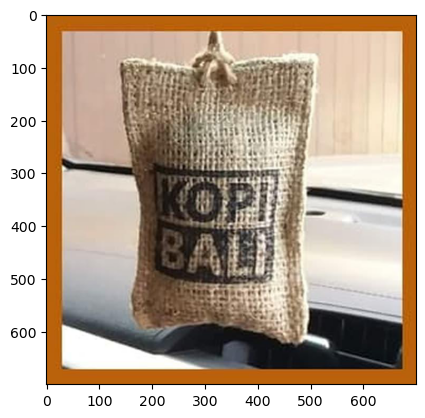

BIJI KOPI BALI PENGHARUM MOBIL DAN RUANGAN
train_1367437374


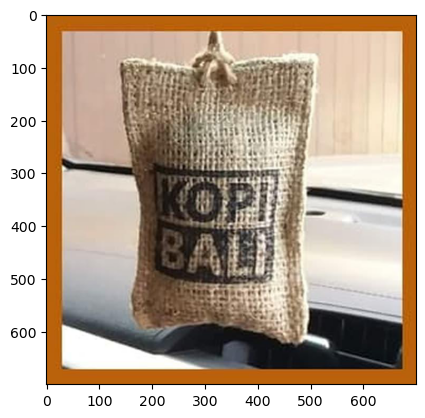

KOPI BALI Parfum Pengharum Mobil Biji Bau ASLI Pewangi Aroma Gantung
train_4267691298


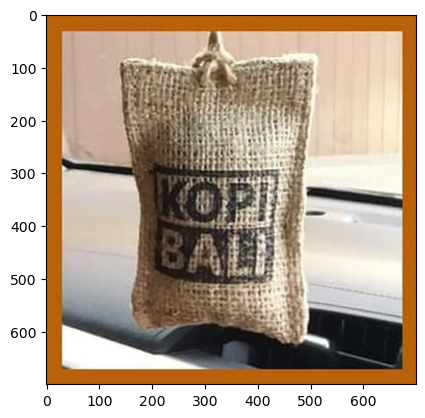

KOPI BALI Parfum Pengharum Mobil Biji KOPI ASLI Pewangi Aroma Gantung
train_2507939814


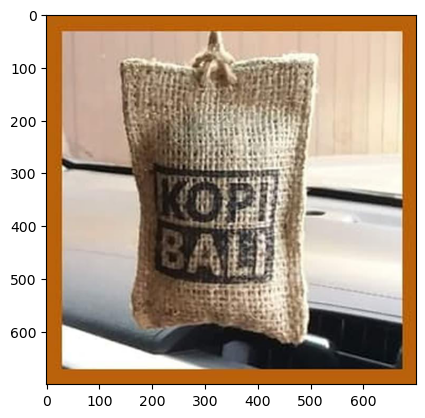

KOPI BALI BIJI KOPI PEWANGI AROMA GANTUNG PENGHARUM MOBIL
train_151380610


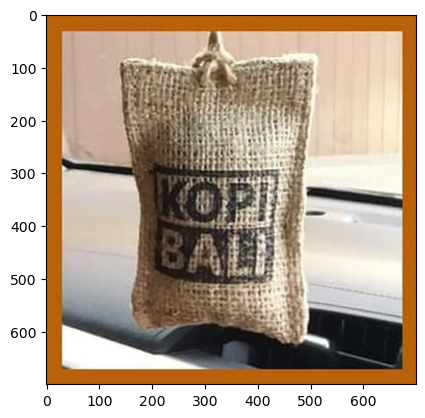

PARFUM PENGHARUM MOBIL BIJI KOPI ASLI - Hitam
train_3681922965


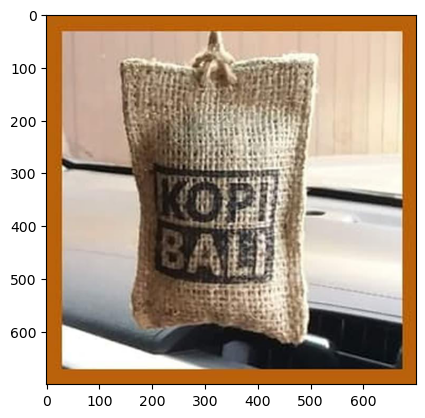

Kurma Sukari 1kg ARA DATES Lembut dan Basah
train_3253166748


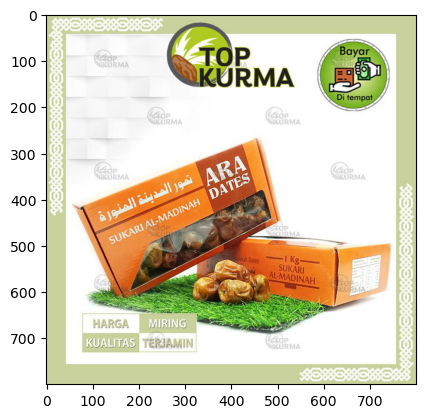

Kurma Sukari 1kg ARA DATES Lembut dan Basah
train_3253166748


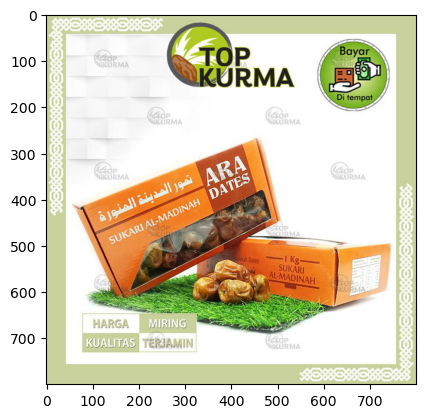

Kurma Shoidi 1 kg Pulen Dan Lembut - Kurma Manis Rasa Sukari Kering
train_2625888864


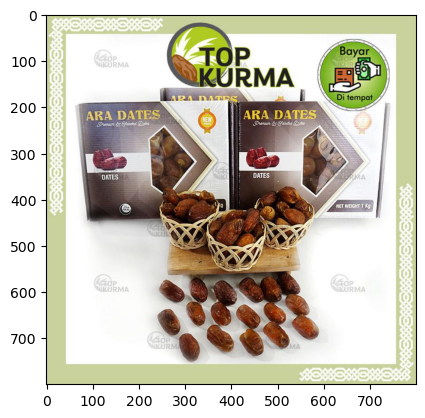

Rak Meja Desktop Storage Box Keranjang Lipat Multifungsi Organizer Mini Basket Kotak Penyimpanan
train_3860506336


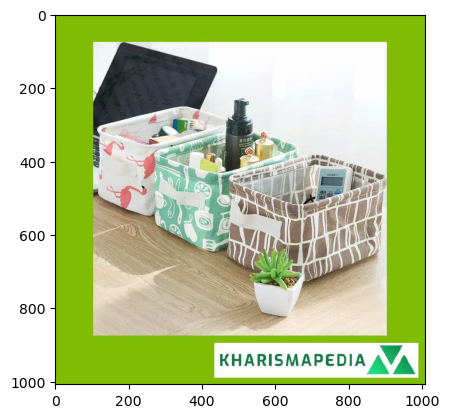

Kurma Sukari Al Madinah Premium NR 1kg
train_113089789


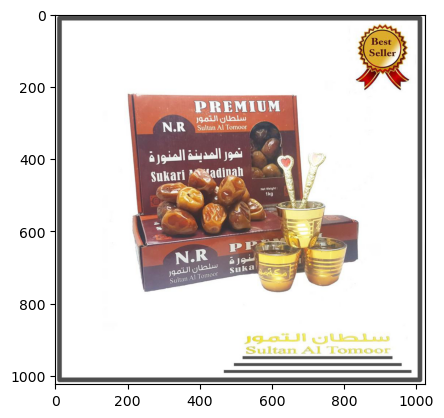

Sabun Tzuki Original Di Jamin !00% Asli
train_2693172383


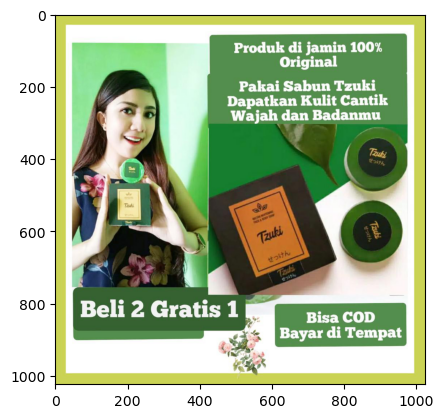

KINDERJOY BOY GIRL T8
train_626830736


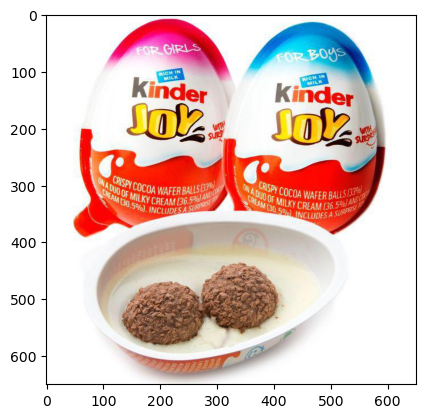

KINDERJOY BOY GIRL T8
train_626830736


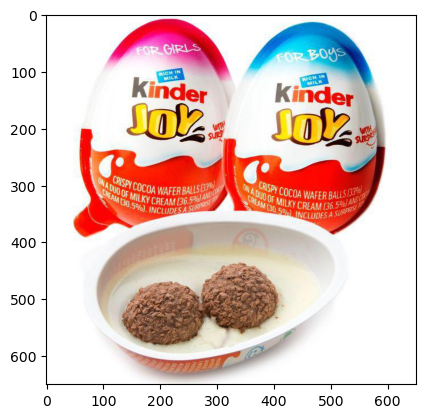

Kinderjoy Boy Ed Desember 2020 PROMO!!
train_4076836319


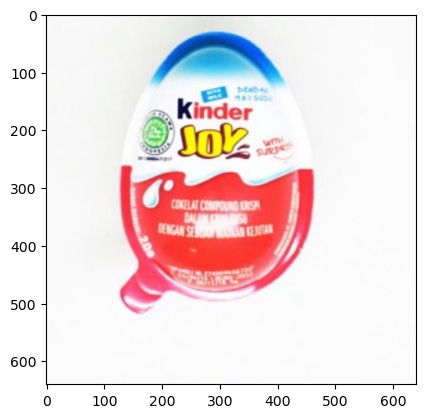

BABYSAFE Soft Spout Training Cup | Baby Cup
train_317776219


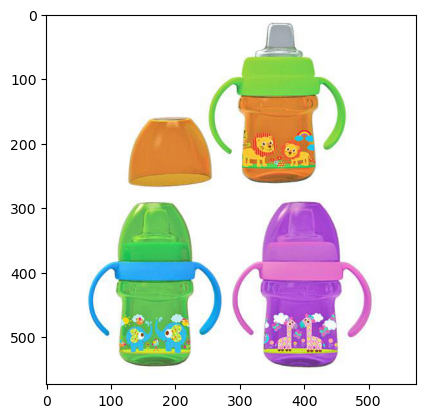

MamyPoko Royal Soft L34 Boy/ XL30 Girl
train_481515401


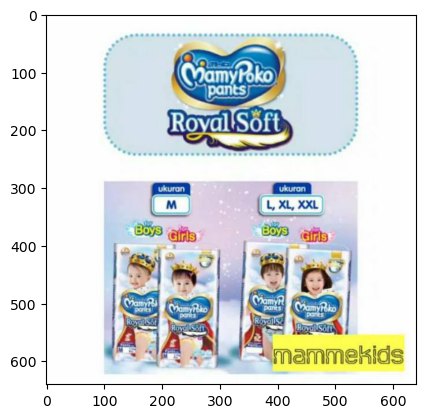

PROMO !! Jilbab Cutemoslem Shafeeya-XS
train_3936157310


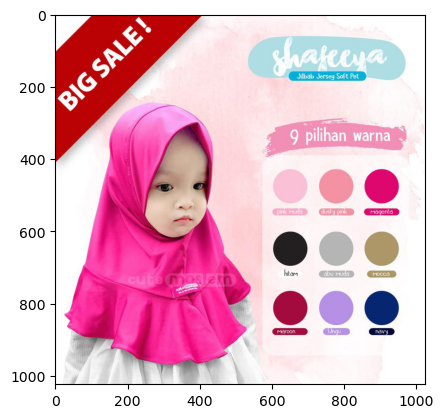

Kompor Elektrik Listrik Induksi Maspion S-300 S300
train_239364386


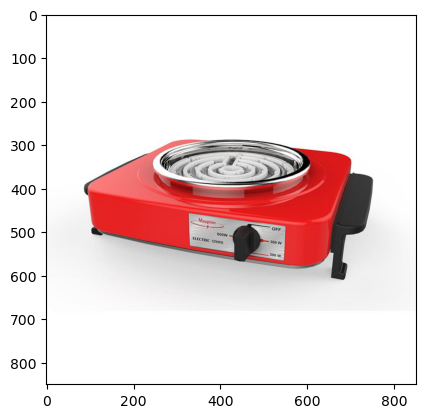

Kompor Elektrik Listrik Induksi Maspion S-300 S300
train_239364386


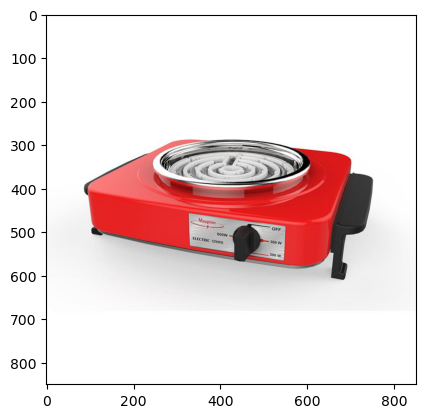

(JM) Bantalan Spons Setengah Jari Kaki Depan Anti Sakit untuk Sepatu
train_1454870450


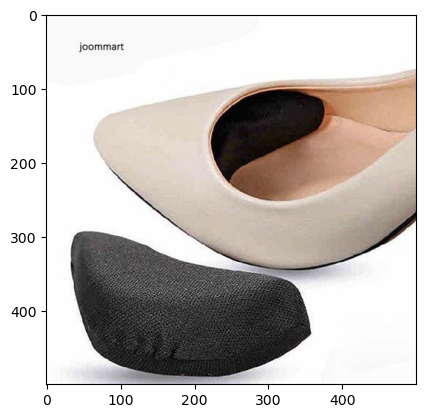

Maspion Setrika Listrik Ha290 Garansi Resmi, Original, Awet&Murah
train_2684957537


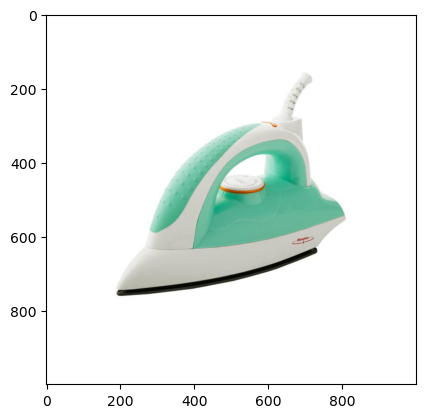

Shinpo 110 CB 30 Container Spark Box Plastik 30 Liter Dengan Roda CB30 Kotak Kontainer
train_1622161379


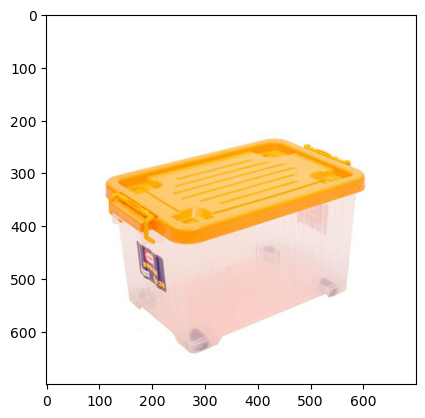

"MITRAANDA88" JAPAN QUALITY Panci Elektrik Multifungsi Electric Fry Pan Panci Listrik Lapis Keramik
train_314696598


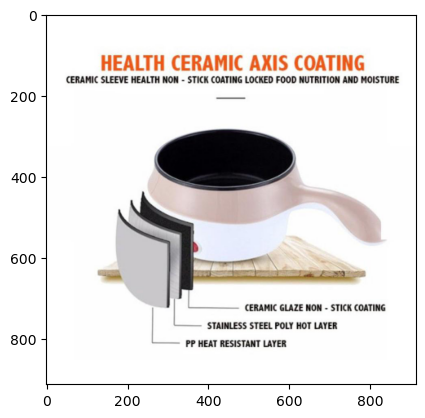

RDL 3 HYDROQUINOE TRETINOIN BABYFACE 60ML
train_1795694766


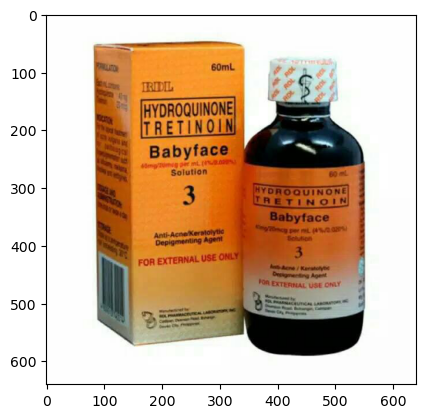

RDL 3 HYDROQUINOE TRETINOIN BABYFACE 60ML
train_1795694766


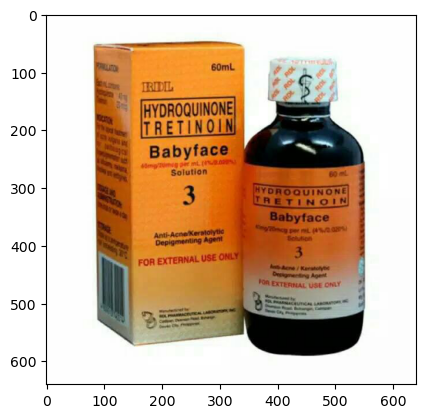

RDL Babyface Solution Toner
train_4225971458


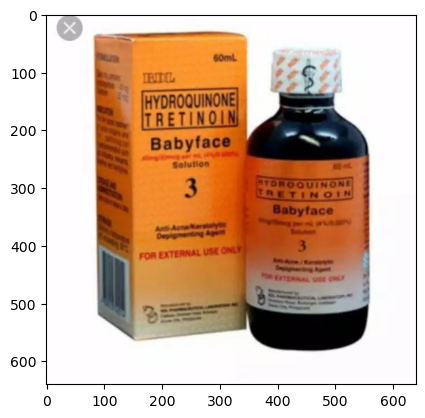

Toner Baby Face RDL Original 100%
train_2291833895


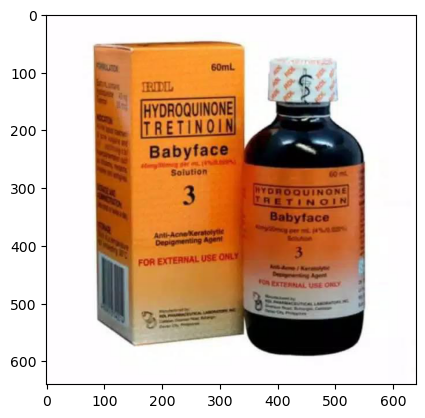

TONER RDL NO3 [ORIGINAL 100%]
train_1130295606


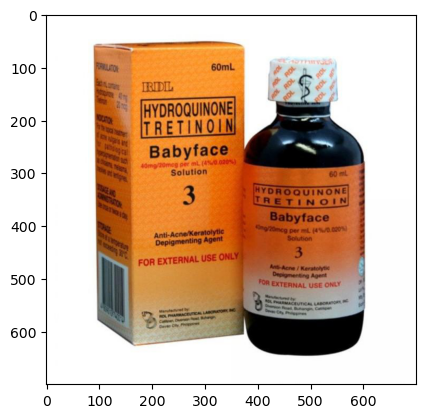

TONER RDL ORIGINAL ANTI ACNE NO2 & 3 FILIPINA
train_2476970777


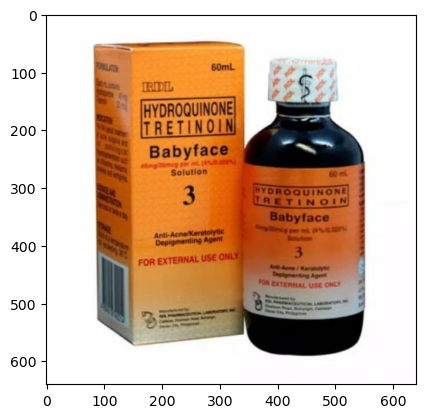

Mazaya Water Body Cologne Men 50ml
train_3135357479


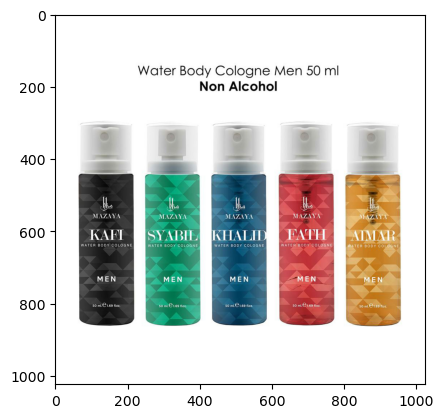

Mazaya Water Body Cologne Men 50ml
train_3135357479


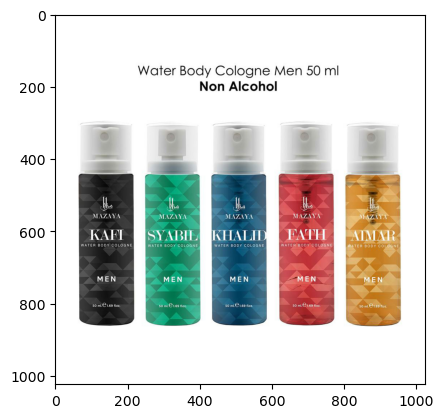

MAUMUKOSMETIK - MAZAYA WATER BODY COLOGNE 50 ML - PAFRUM
train_497428540


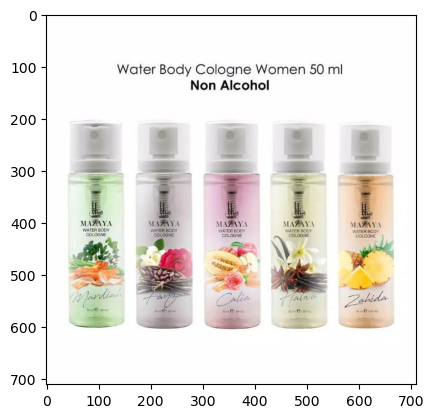

Sido Muncul Sari Kunyit 50 Kapsul
train_3341686577


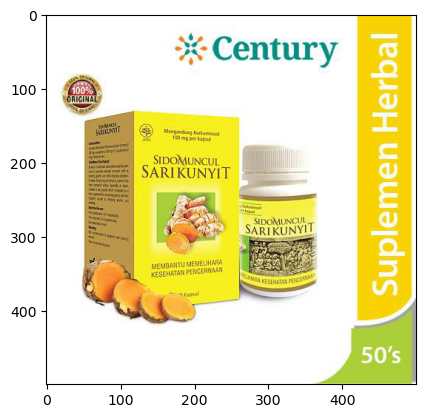

My Bottle Karakter Animal 500ml (H-302)
train_2761508353


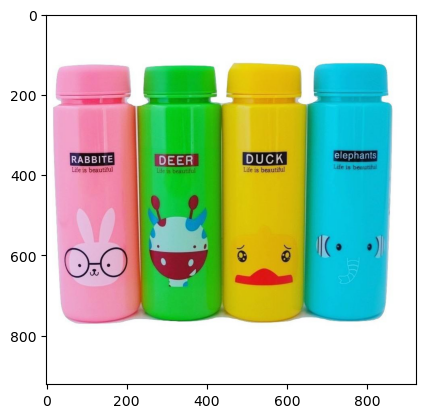

Botol minum kapasitas 2 liter / water pot bottle SELIYA 2 L with sedotan
train_1072427985


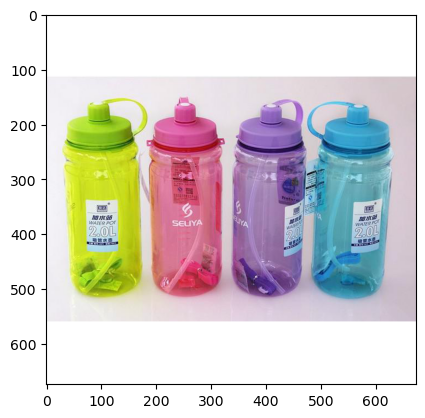

SASIMI Aloe Vera 99% Lip Tint/Lip Gloss 1pcs
train_4212314878


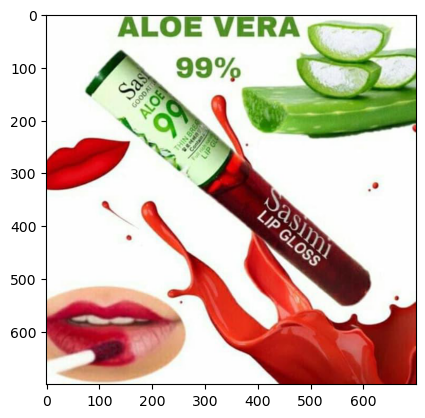

SASIMI Aloe Vera 99% Lip Tint/Lip Gloss 1pcs
train_4212314878


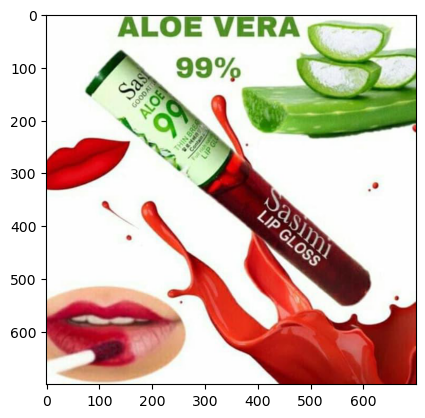

sasimi liptint aloevera 99% ( ECER )
train_1445254566


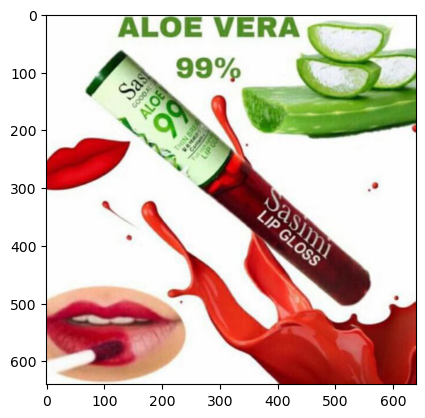

Sasimi Lipgloss Aloe vera / liptint aloe vera
train_2243880041


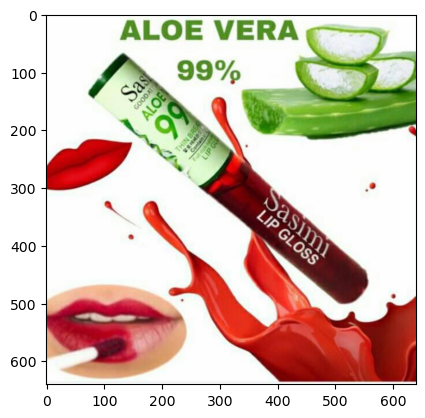

[MURAH] LIPTINT ALOE VERA / aloevera Sasimi SASIMI Aloe Vera 99% Lip Tint / Lip Gloss 1pcs
train_1293972698


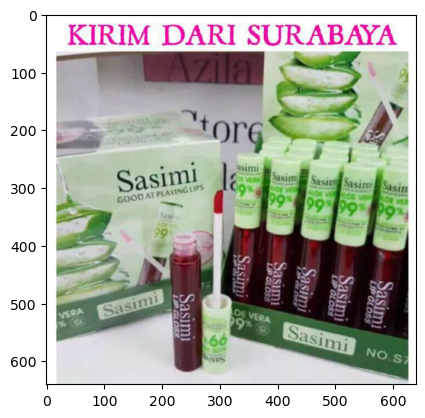

IMPLORA CHEEK & LIPTINT - IMPLORA LIP TINT ORIGINAL BPOM
train_4206743389


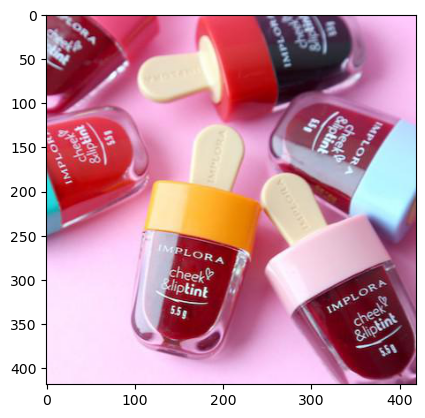

MUKENA ANAK LOL LED 3-6thn
train_2678784958


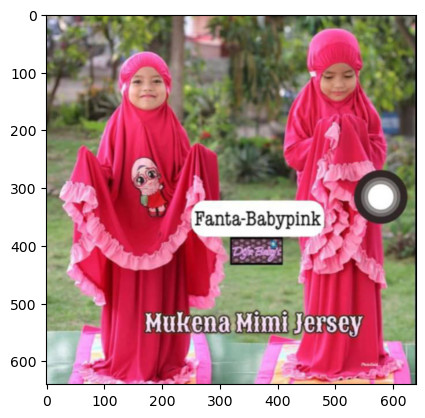

MUKENA ANAK LOL LED 3-6thn
train_2678784958


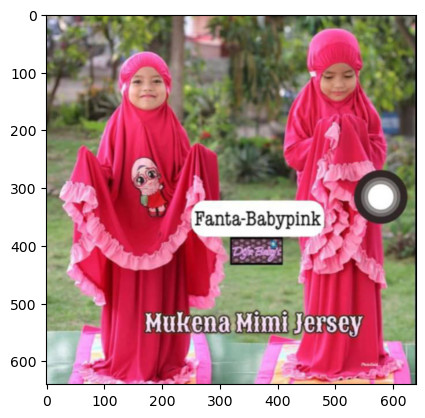

MUKENA ANAK LOL /LOL LED
train_3748656857


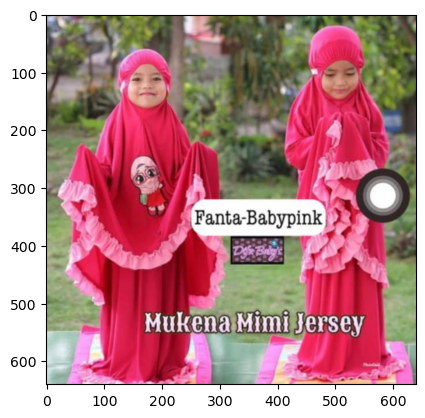

Obral lampu led 3w 3watt murah merk venusia bukan philips
train_2481624849


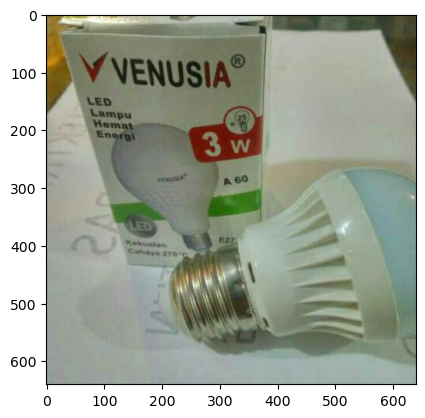

Baju Kaos Anak Laki Laki Gambar DINOSAURUS TREX NEON NAVY Terlengkap
train_2525160586


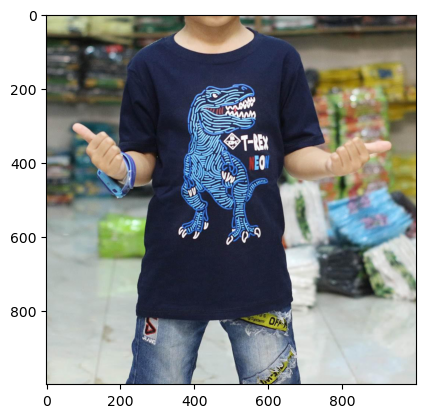

Sepatu Sneakers Olahraga Bahan Kanvas Elastis Kualitas Bagus untuk Anak Laki-laki / Perempuan
train_2725472363


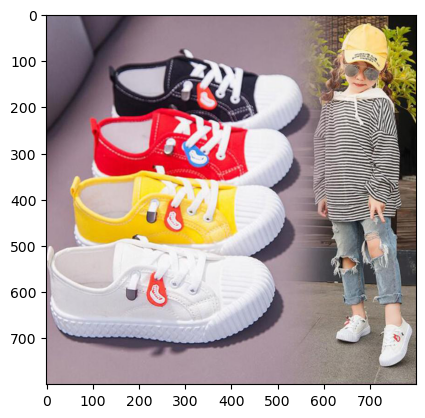

Gas Hi Cook
train_4002648940


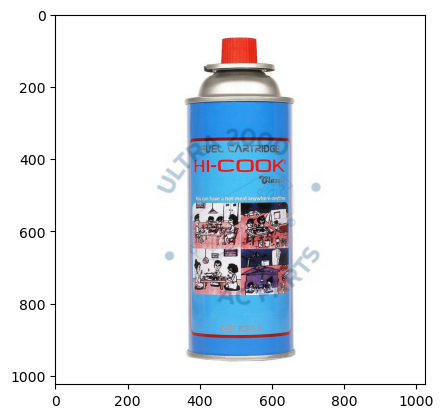

Gas Hi Cook
train_4002648940


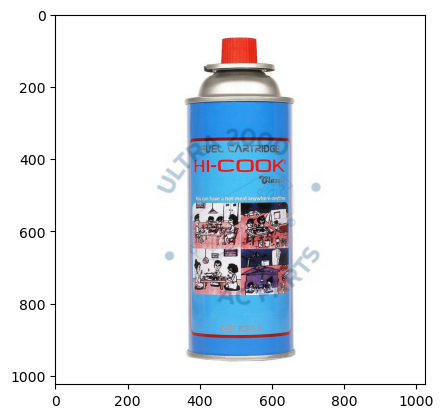

Bertolli Classico Olive Oil 100ml
train_2319343608


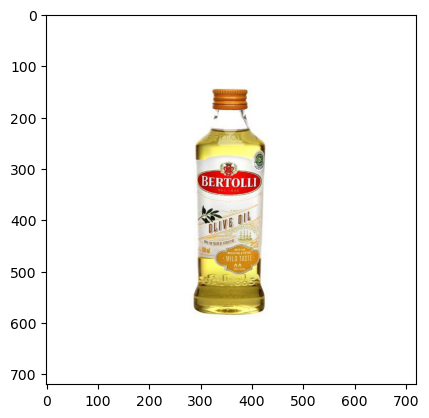

Kitoderm Facial Soap Acne Tea Tree Oil (Hijau) - Sabun wajah jerawat
train_1675185549


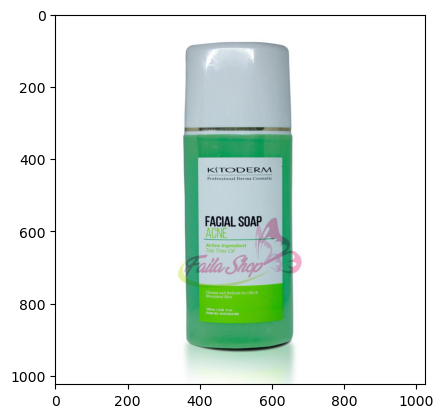

SOME BY MI AHA BHA PHA 30 Days Miracle Toner 150ml 100% Original Korea
train_2123027136


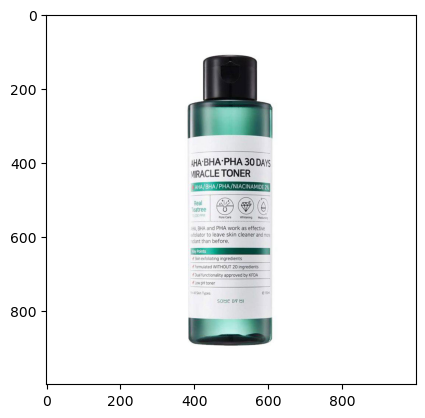

Somebymi aha bha pha 30days miracle toner 150ml
train_366017671


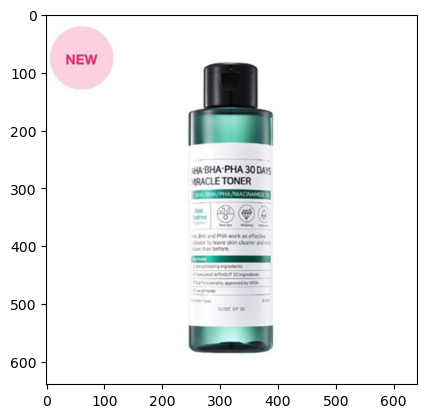

Wipol Sabun Karbol Pembersih Lantai Karbol Cemara Perlindungan Dari Kuman 750 ml
train_4266532350


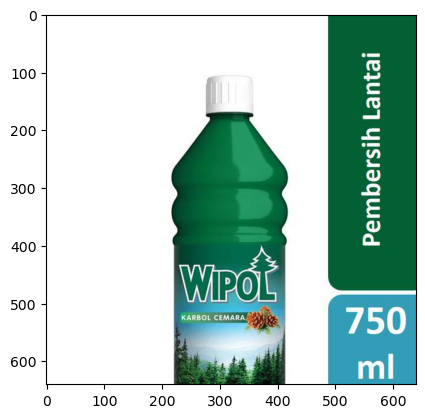

Wipol Sabun Karbol Pembersih Lantai Karbol Cemara Perlindungan Dari Kuman 750 ml
train_4266532350


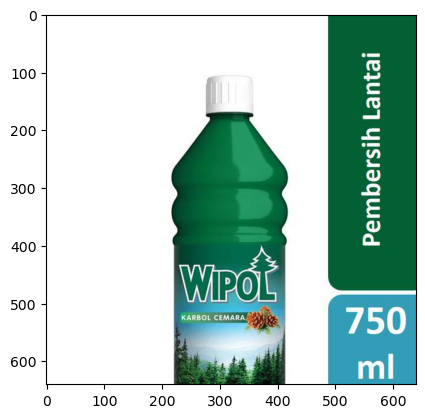

PROMOSI WIPOL 750ml BOTOL CAIRAN KARBOL DISINFEKTAN PEMBUNUH KUMAN BAKTERI AMPUH DISKON MURAH
train_1113037282


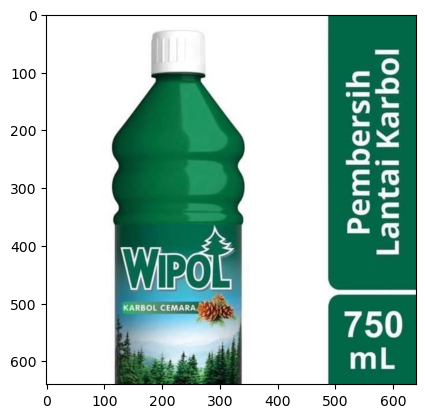

KARBOL PEMBERSIH LANTAI CAIRAN DISINFEKTAN WIPOL BOTOL 450 ML
train_1820535872


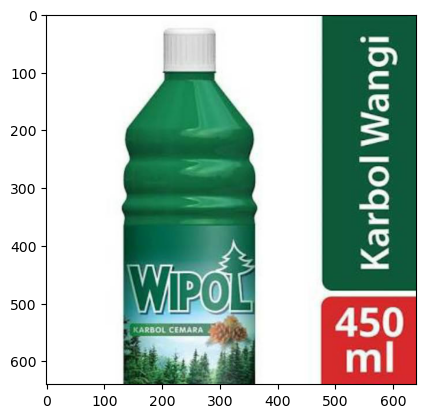

KARBOL CAIRAN DISINFEKTAN WIPOL 450 ML BOTOL PEMBERSIH LANTAI ANTI BAKTERI ANTI KUMAN
train_3661528111


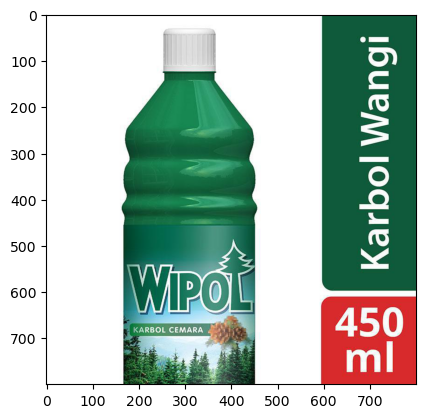

Wipol Karbol Pembersih Lantai Botol 450Ml
train_2789459959


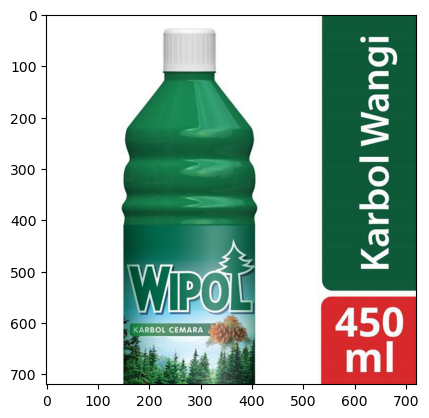

In [24]:
%matplotlib inline
index =0
for item in postingidList:
    print(titleList[index])
    print(keyList[index])
    imagePath = 'train_images/'+ imageList[index]
    pil_im = Image.open(imagePath, 'r')
    plt.figure()
    plt.imshow(pil_im)
    plt.show()
    matching_indices = matchesList[index].split(' ')
    print('==================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        print(keyList[int(ind)])
        imagePath = 'train_images/'+ imageList[int(ind)]
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
    index= index +1
    if index == 10:
        break
    

In [25]:
testkeyList=[]
testcembList=[]
testimageList=[]
testtitleList=[]
for index, row in X_test.iterrows():
    #start_time=time.time()
    txt_emb = get_textEmbeddings(model,str(row[3]))
    imagePath = 'train_images/'+row[1]
    img_emb = get_imageEmbeddings(img_model,imagePath)
    text_embeddings[row[0]] = txt_emb
    image_embeddings[row[0]] = img_emb
    cmb_emb = np.concatenate((txt_emb,img_emb),axis=0)
    norm = np.linalg.norm(cmb_emb)
    cmb_emb_normal = cmb_emb/norm
    testkeyList.append(row[0])
    testcembList.append(cmb_emb_normal)
    testimageList.append(row[1])
    testtitleList.append(row[3])

C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\230648310.py:7: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  txt_emb = get_textEmbeddings(model,str(row[3]))
C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\230648310.py:8: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  imagePath = 'train_images/'+row[1]
C:\Users\RohithSai\AppData\Local\Temp\ipykernel_14264\230648310.py:10: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  text

In [26]:
testpostingidList=[]
testmatchesList=[]
index =0
for val in testkeyList:
    query_emb = testcembList[index]
    postingid_list = getNeighbours(query_emb)
    testpostingidList.append(val)
    testmatchesList.append(" ".join(postingid_list))
    index =index +1 
    if index==100:
        break

Wardah Lightening Micellar Gentle Wash 100 ml
train_3745470112


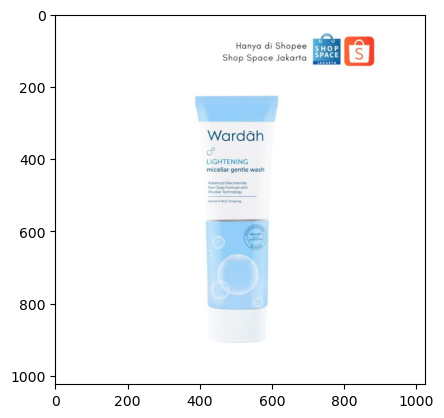

Wardah Lightening Micellar Gentle Wash 100 ml
train_2661254633


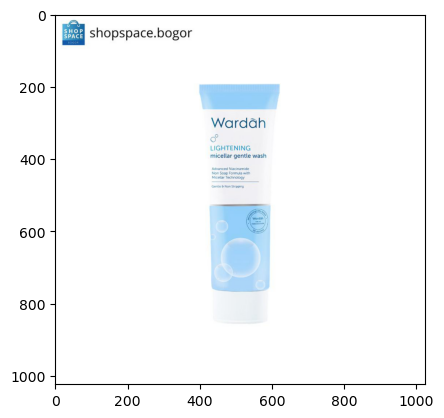

Wardah Lightening Micellar Gentle Wash 100 ml
train_1577017745


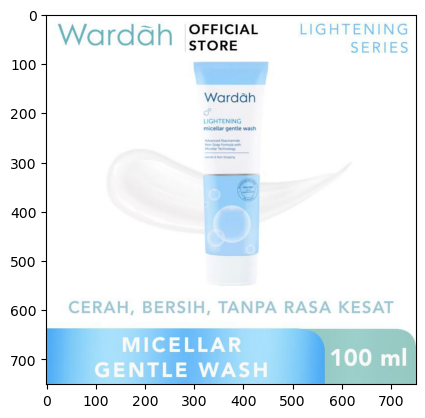

Wardah Lightening Day Cream Advanced Niacinamide 20 ml
train_3032730238


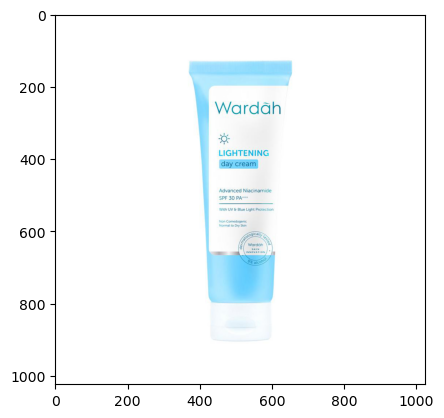

Acnes Creamy Wash 100 gr
train_3893154840


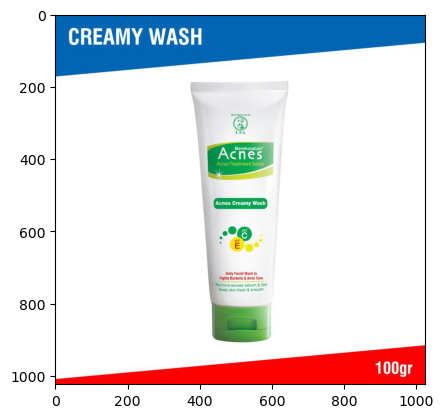

[Gift] Vaseline Healthy White Fresh & Fair Cooling Uv Gel Lotion 100 ml
train_369801432


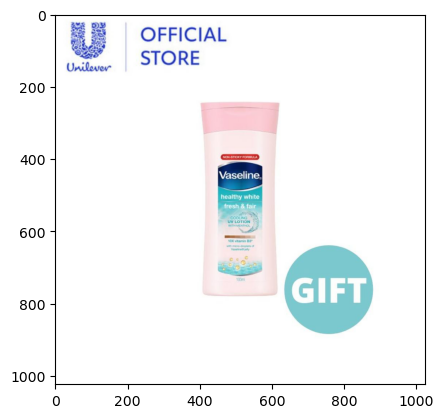

SEPATU WANITA / SNEAKERS DP06
train_786962322


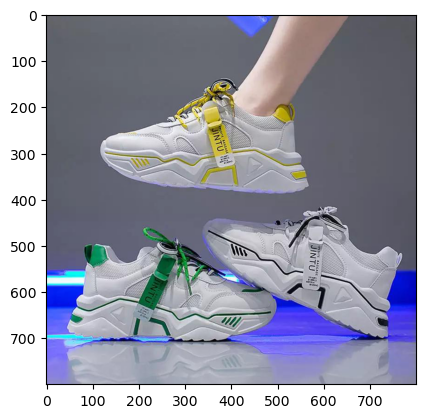

SEPATU SNEAKERS WANITA JINTU
train_1088375361


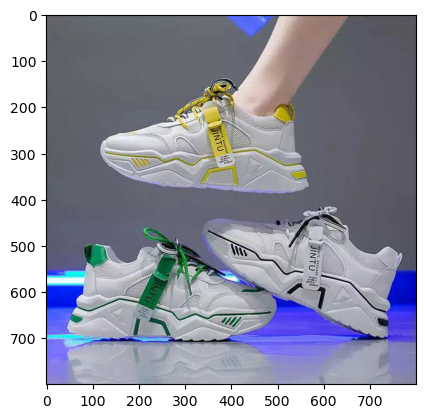

SEPATU SNEAKERS WANITA JINTU
train_154076652


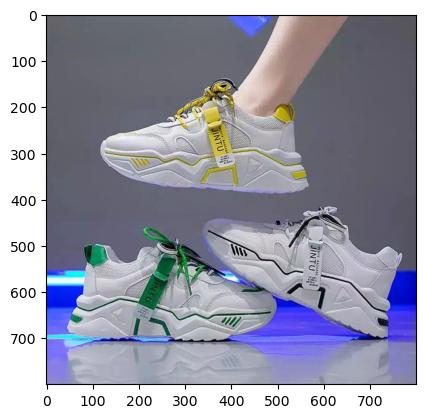

SEPATU WANITA JINTU KOREA 2020
train_863268112


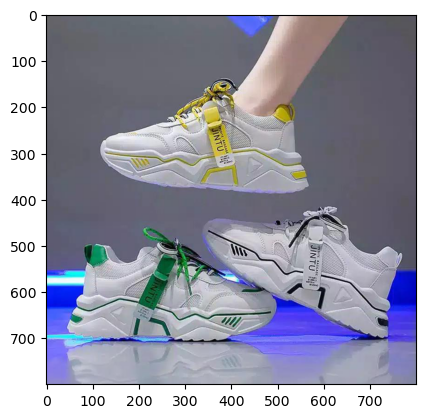

Sepatu Korea Jintu 2020 Wanita Sneakers Cewek Sneaker Sol Karet Putih Fashion Korea Murah Kekinian
train_416640140


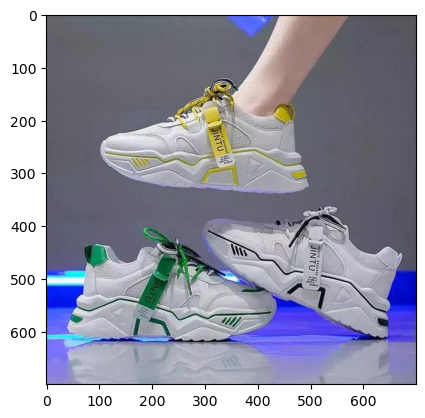

SEPATU SNEAKERS WANITA M DV 98
train_848190683


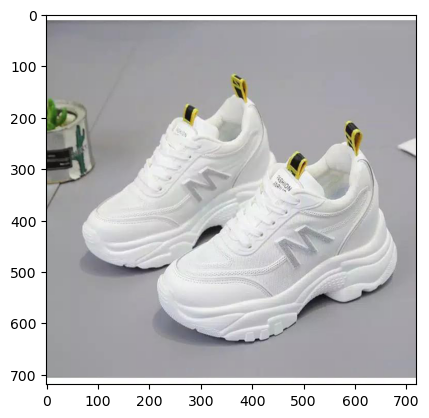

Sustagen Kid 3 Vanila 1200 gr - Susu Anak 3-6 Tahun
train_3177453990


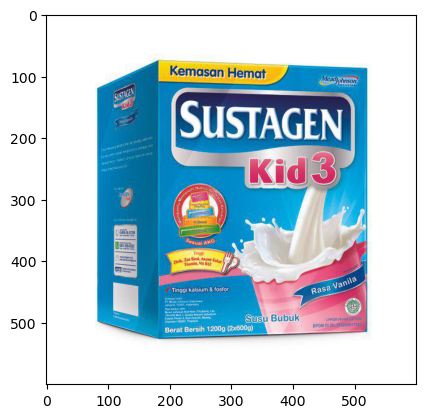

Sustagen Kid 3+ Vanila 800 gr 
train_752492581


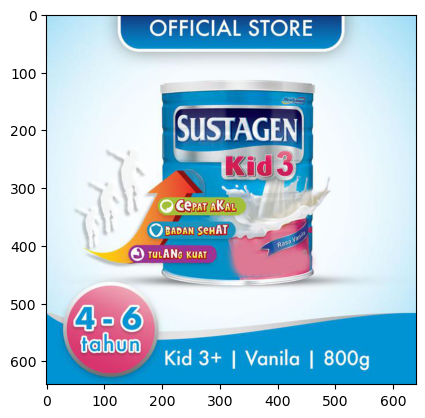

susu sustagen kid 3 rasa vanila / madu 800gr
train_3334600223


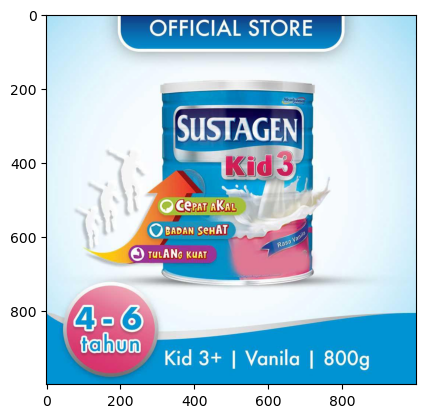

Bebelac Gold 3 Vanila Susu Formula [700 g]
train_3455969887


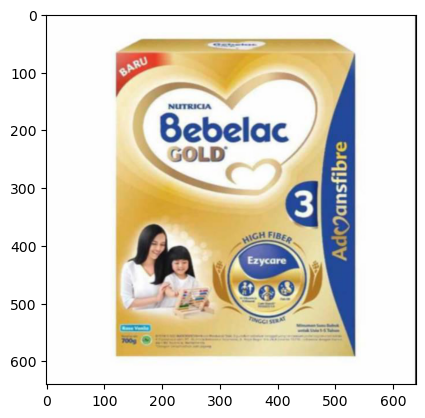

Entrasol Gold 370gr Plain/Coklat/Vanila usia 51th keatas
train_3207885554


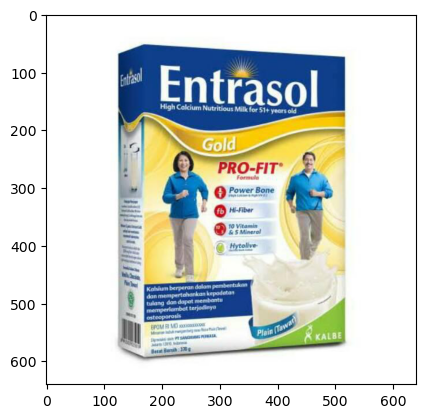

Sustagen School 6+ Vanila 800 gr - Susu Anak 6-12 Tahun
train_4021447310


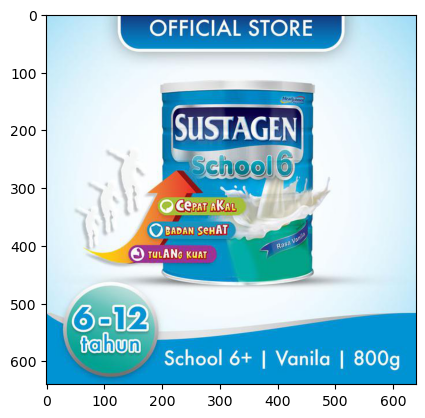

TERBARU SEPATU Sneakrs Pria /wanita/SEPATU XBC SEPATU pria TALI HARGA ter murah COD
train_1363178471


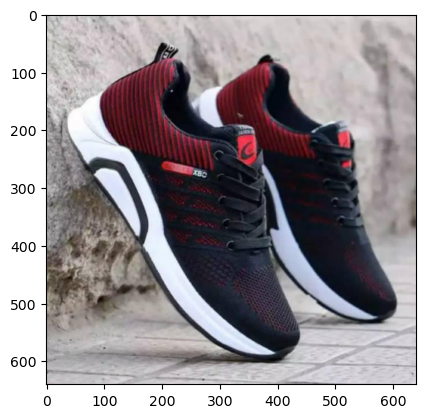

SEPATU SNEAKERS PRIA/WANITA XBO SPORT
train_3975818767


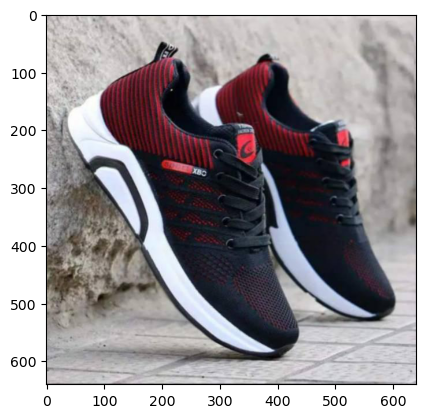

NEW!!! SEPATU SNEAKERS XBO SPORT PRIA DAN WANITA
train_64605450


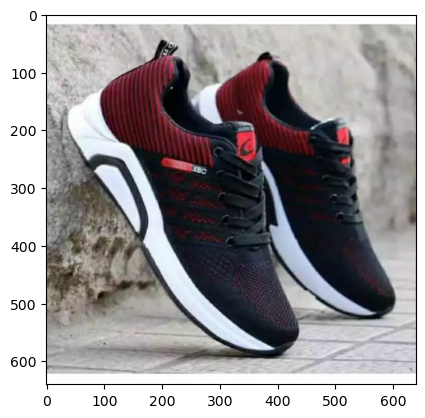

NEW !!! SEPATU SNEAKERS PRIA DAN WANITA XBO SPORT
train_3674965497


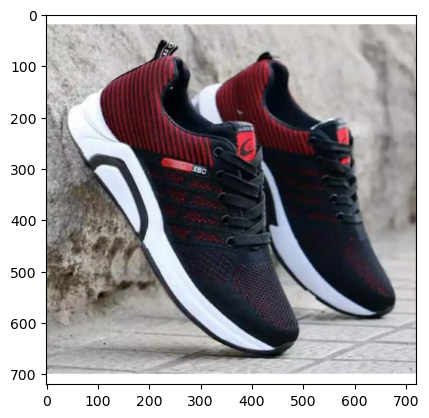

NEW!!! SEPATU SNEAKERS XBO SPORT
train_328393562


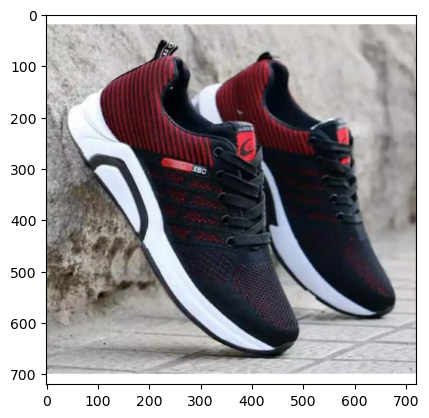

100 pcs karet ikat rambut elastis
train_2566709185


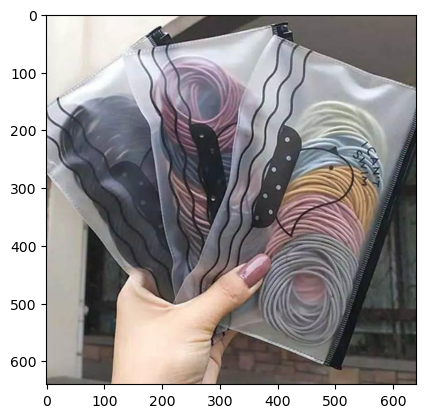

KARET KUCIR PREMIUM
train_4184037897


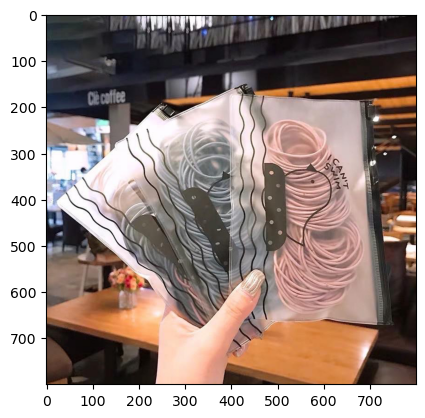

100Pcs Ikat Karet Rambut Elastis Warna Polos Gaya Korea untuk Wanita
train_880338666


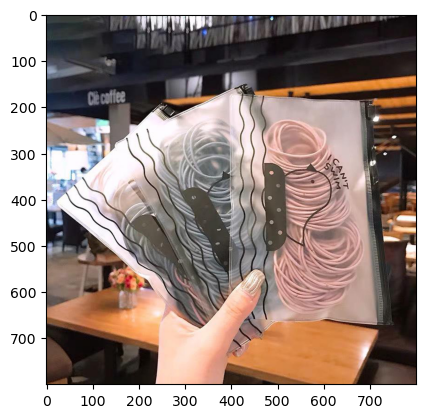

100Pcs Karet Ikat Rambut Elastis untuk Wanita
train_1010868925


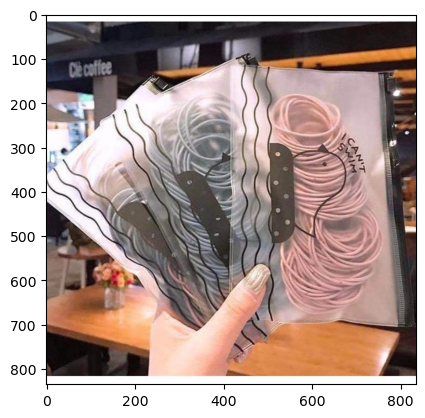

GAMIS MONALISA PREMIUM/GAMIS MOTIF
train_370764966


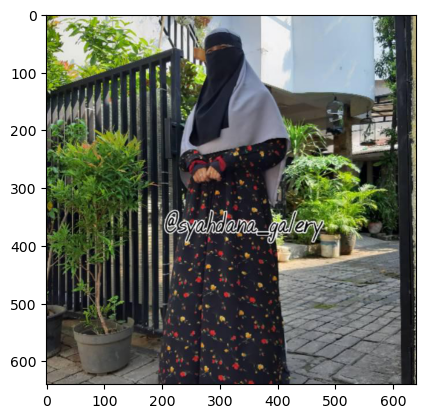

IKAT RAMBUT  POLOS KARET RAMBUT WARNA WARNI MURAH MERIAH
train_2351628006


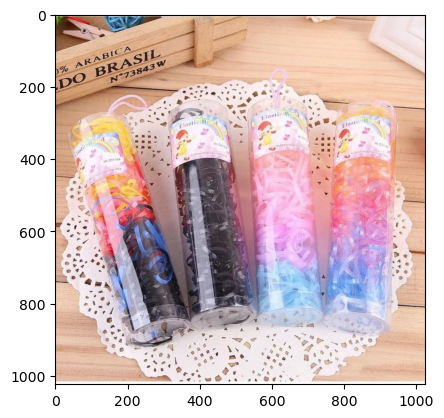

CATTY TEMPAT PENSIL TRANSPARAN KARAKTER TEMPAT KOSMETIK KOTAK PENSIL MURAH BATAM IMPORT
train_3415444169


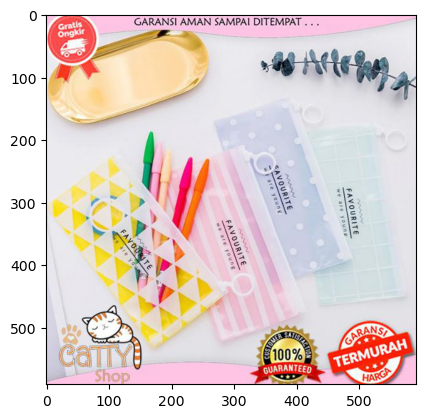

Piyama POPPY BIRU bisa couple mom kids and family
train_3574331912


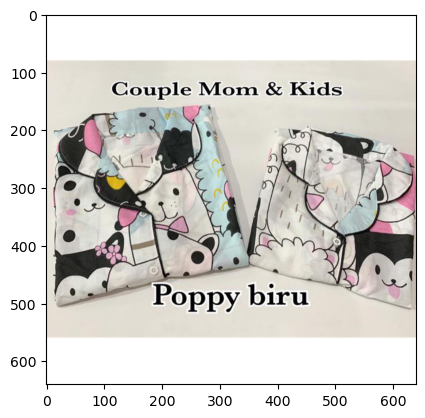

Couple mom and kids poppy biru
train_2202815896


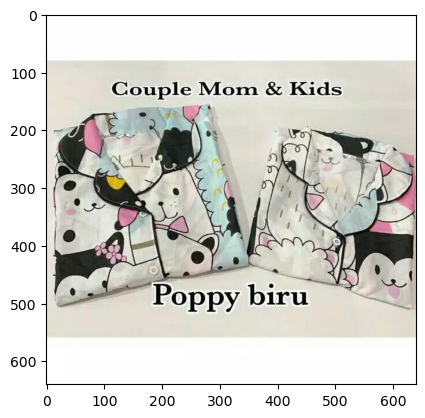

Baby Joy Gendongan Bayi Depan Baby Joy - Baby Joy Gendongan Hipseat Kokoa Series BJG 3029
train_817032823


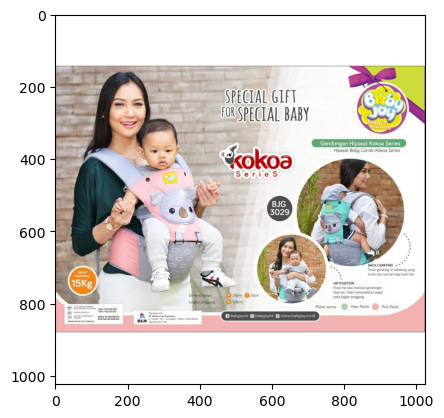

Mama Bear tea/tea pelancar asi/asi booster
train_2600730584


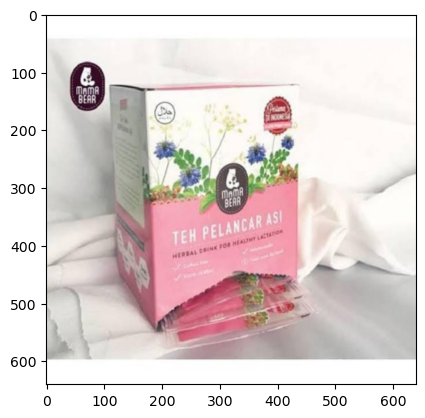

MOMS BABY-TAS RANSEL PERLENGKAPAN BAYI MOMS BABY OTHELLO SERIES MBT 3031-TAS RANSEL BAYI MURAH
train_3010824279


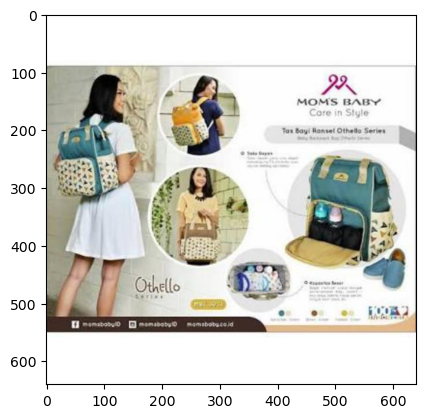

3pcs Libby Baby Setelan Bayi lengan pendek Celana pendek
train_514768269


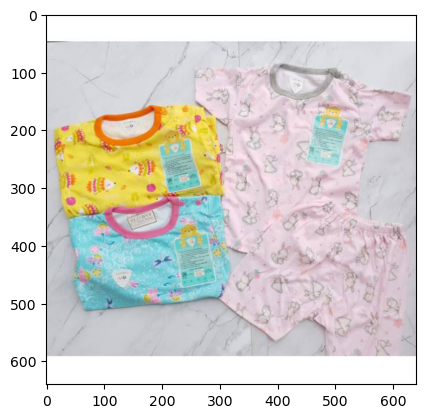

[ready stock free gift] SuperBoss Gluta Collagen Soap Beautetox Skinsuperstar
train_2258929039


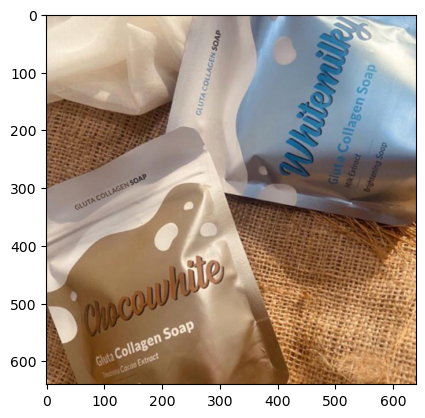

[READY STOCK]  GLUTA COLLAGEN SOAP / GCS KEMASAN TERBARU BEAUTETOX
train_4286138740


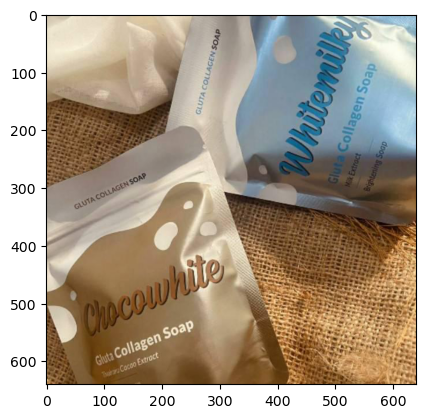

READY STOCK FREE GIFT GLUTA COLLAGEN SOAP BEAUTETOX
train_2902736490


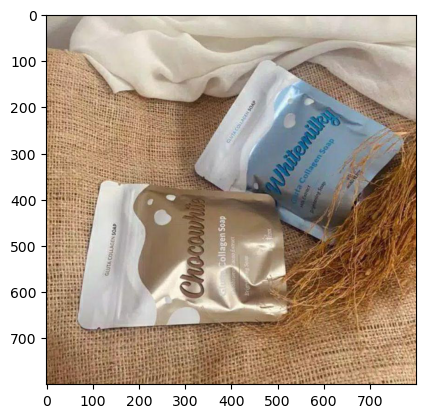

[READY STOCK] GLUTA COLLAGEN SOAP BEAUTETOX
train_2266041454


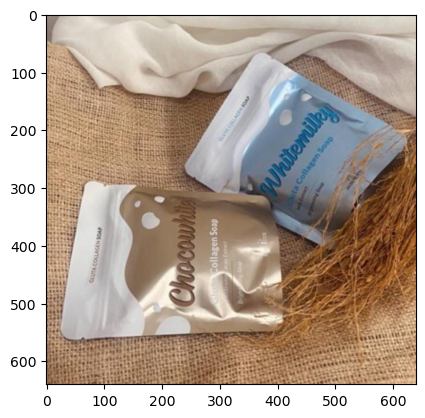

[READY]GLUTA COLLAGEN SOAP THE3ANGLE BEAUTETOX SKINSUPERSTAR
train_2513892071


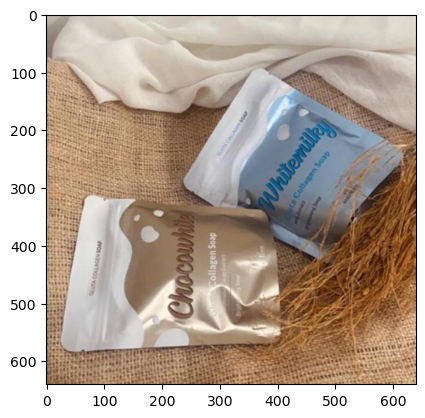

[READY, BISA COD]  BPOM GLUTA COLLAGEN SOAP BEAUTETOX SKINSUPERSTAR THE3ANGLE
train_1061695682


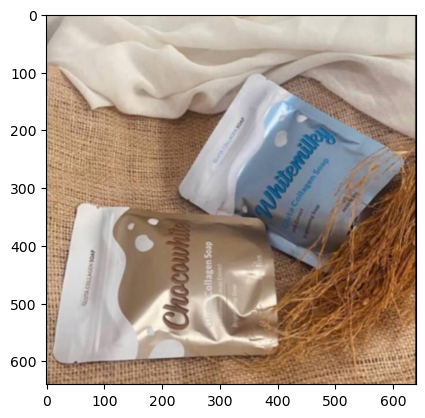

mainan bayi gantung putar musik merry go round
train_835214606


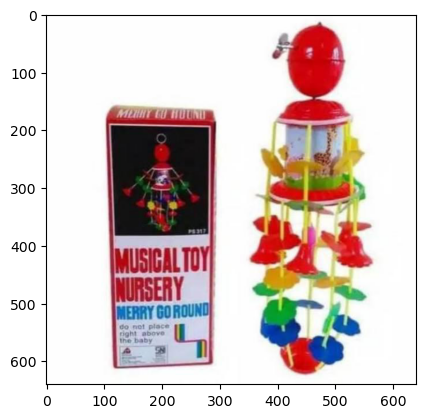

MERRY GO ROUND MAINAN BAYI GANTUNG MUSIK PUTAR/KERINCINGAN BAYI
train_2351169821


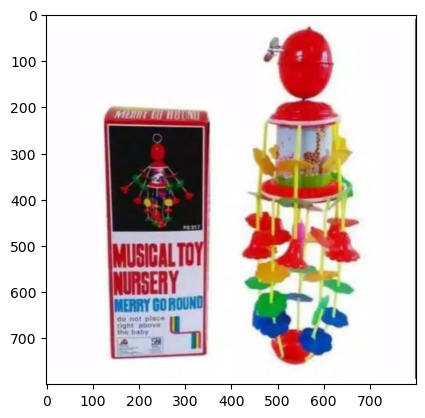

merry go round mainan musikal kerincingan bayi
train_3149639722


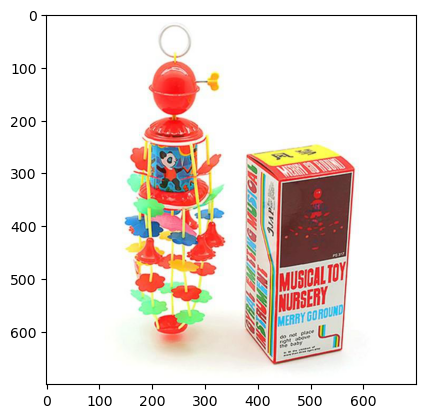

MERRY GO ROUND MUSICAL TOYS - MAINAN GANTUNGAN BAYI  NO. PS317
train_242717430


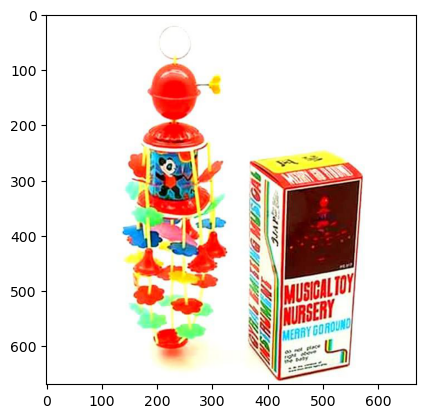

Merry Go Round PS317 - Mainan Bayi Gantung Putar
train_827596102


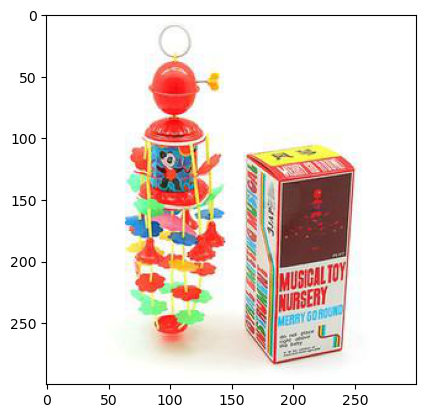

Mainan Anak Bayi Merry Go Round Musical Toys Krincingan bayi baby
train_324982893


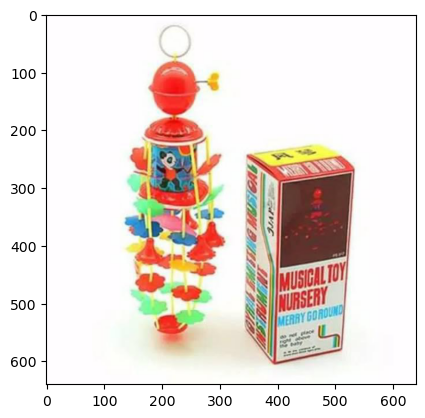

KIRANAOFFICIAL - (COD) RUBY OUTER / OUTWEAR POLOS cardigan ( B24 / B25 / AF03 )
train_26822064


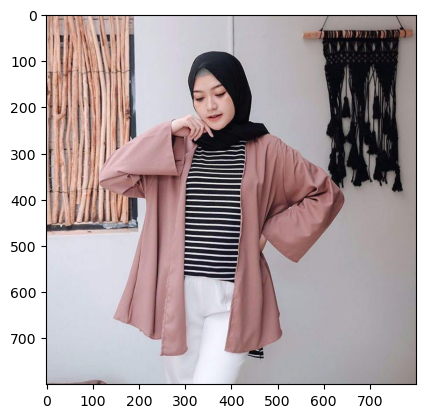

YAO YAO Kanaya Outer / Kardigan Moscrepe Polos Rempel Kekinian
train_3505386994


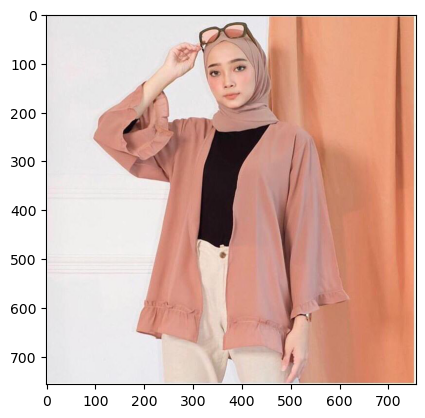

Casing Soft Case Warna Permen Xiaomi Redmi note 9 9S 9pro 8 4A 4x 5A 6A S2 Note 5 5A 6 6pro
train_3972276902


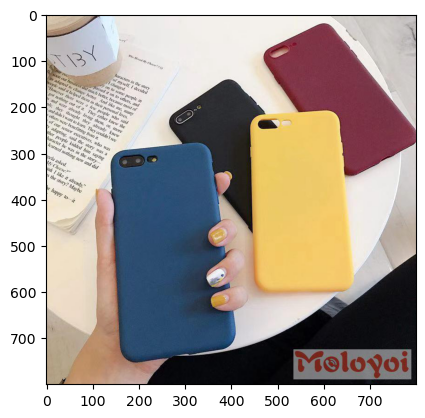

b"Wenela Couple Syar'i SET GAMIS + KHIMAR KEMEJA MAYRA CP TERLARIS VH1"
train_611239274


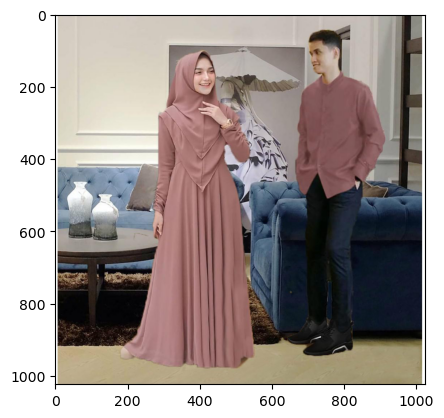

Casing Soft Case Silikon untuk Vivo Z1pro S1pro V17pro Y19 V19 y91 y93 y95 S1 V11 V15 y71 V11 V15 y17 Y19 vbb
train_1462389903


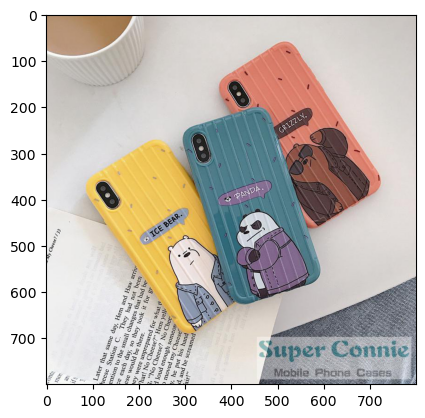

Case for iPhone 12 Mini iPhone 12 Pro Max Soft Case Cover Proteksi Shockproof Warna Polos untuk iPhone 6 7 8 Plus X  iPhone 11 Pro Max casing
train_763038638


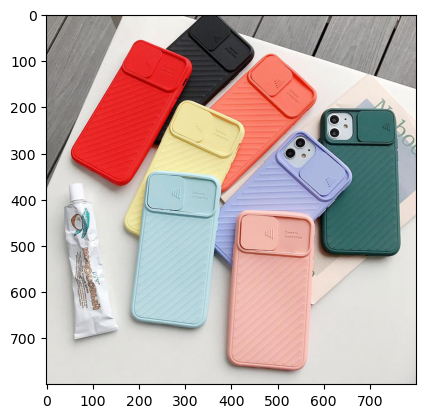

[ Paket Glowing ] PAKET THERASKIN GLOWING 4IN1 ORIGINAL
train_2878082872


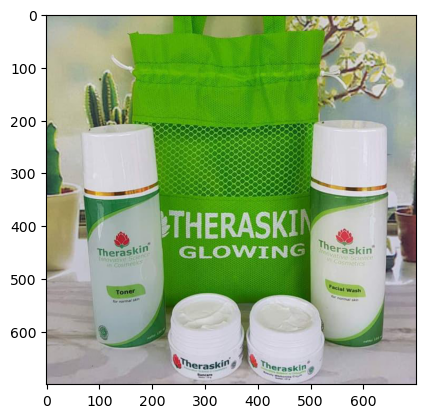

Paket Theraskin Glowing
train_3287334814


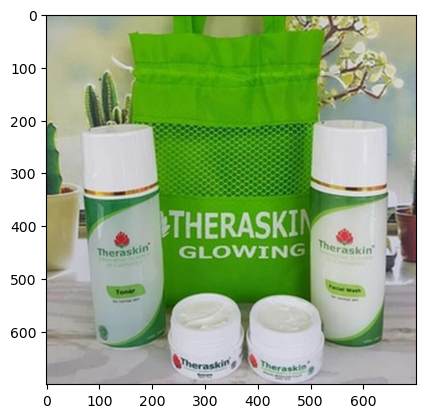

THERASKIN PAKET ACNE WHITE GLOW ISI 4
train_3028267051


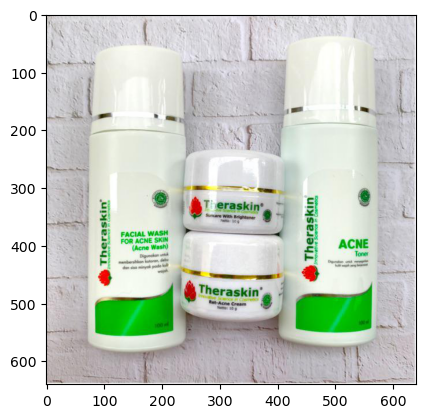

MANGKUK MASKER SET MURAH ( KUAS MASKER + MANGKOK MASKER ) 4IN1
train_2005215286


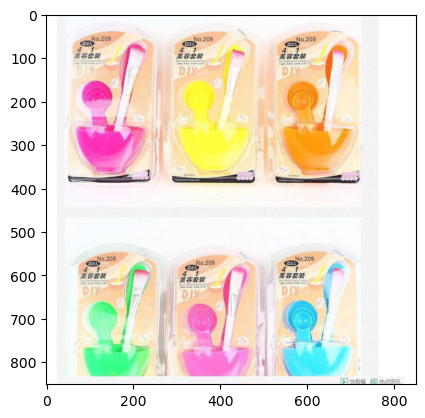

PAKET CREAM COLLAGEN ORIGINAL 4in1
train_1575813596


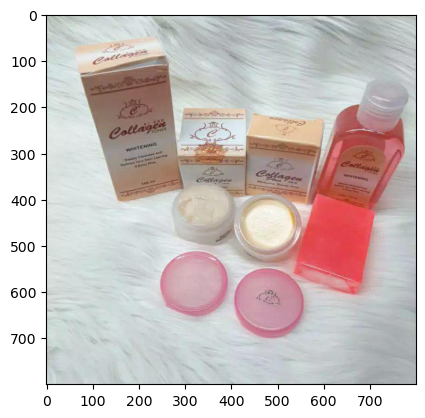

ERTOS PAKET GLOWING
train_2528673251


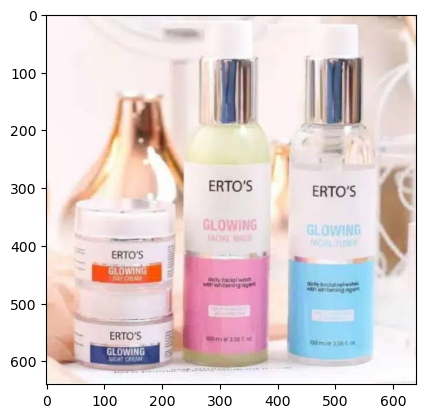

In [27]:
%matplotlib inline
index =10
while index <20:
    print(testtitleList[index])
    print(testkeyList[index])
    imagePath = 'train_images/'+ testimageList[index]
    pil_im = Image.open(imagePath, 'r')
    plt.figure()
    plt.imshow(pil_im)
    plt.show()
    matching_indices = testmatchesList[index].split(' ')
    print('==================')
    for ind in matching_indices:
        print(titleList[int(ind)])
        print(keyList[int(ind)])
        imagePath = 'train_images/'+ imageList[int(ind)]
        pil_im = Image.open(imagePath, 'r')
        plt.figure()
        plt.imshow(pil_im)
        plt.show()
    index= index +1
   
    